# UTILITIES

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# more outputs from a single cell
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [ ]:
!pip install gower
!pip install -U scikit-learn_extra
!pip install delayed

  Created wheel for gower: filename=gower-0.0.5-cp37-none-any.whl size=4232 sha256=b15b3c05638fd829ef8ab78ace5417338315847afcc2a34acf50c271a0ffeeb3
  Stored in directory: /root/.cache/pip/wheels/c0/09/9b/072d54d6ced0f43a179852e3f09532d0131e25ff7cb4e5ee75
Successfully built gower
     |████████████████████████████████| 1.7MB 2.9MB/s 
     |████████████████████████████████| 22.3MB 128kB/s 
  Found existing installation: scikit-learn 0.22.2.post1
    Uninstalling scikit-learn-0.22.2.post1:
      Successfully uninstalled scikit-learn-0.22.2.post1
     |████████████████████████████████| 92kB 2.2MB/s 
     |████████████████████████████████| 81kB 5.6MB/s 


In [ ]:
import os

import pandas as pd
import numpy as np
import tensorflow as tf
import seaborn as sns

sns_c = sns.color_palette(palette='deep')

%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.cm as cm

from scipy import sparse
from scipy import linalg
from sklearn import preprocessing
from sklearn.metrics.pairwise import pairwise_distances
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA, FastICA
from sklearn_extra.cluster import KMedoids
from sklearn.neighbors import kneighbors_graph
from sklearn.cluster import SpectralClustering, DBSCAN
from sklearn.metrics import silhouette_score, silhouette_samples, calinski_harabasz_score, davies_bouldin_score

import gower

from tensorflow import keras 
from tensorflow.python.keras.models import Sequential
from tensorflow.python.keras.layers import Dense

In [ ]:
# SEED to make experiments reproducible 
SEED = 1234
np.random.seed(SEED)
tf.random.set_seed(SEED)

# DATASET
Reading of the csv file and printing some of its feature like shape and dtypes. No data cleaning operations are needed, the dataset is already ready to use.

In [ ]:
DATA_FOLDER = './'
raw = pd.read_csv(os.path.join(DATA_FOLDER, 'BankClients.csv'), sep=';')
raw = raw.drop(labels=['ID'], axis=1)

# printing
print("Type of the dataset:\n\n", raw.dtypes)
print("\n\n")
print("\nSize of the dataset (row, col): ", raw.shape)
print("\n\n")
raw

Type of the dataset:

 Age              int64
Gender           int64
Job              int64
Area             int64
CitySize         int64
FamilySize       int64
Income         float64
Wealth         float64
Debt           float64
FinEdu         float64
ESG            float64
Digital        float64
BankFriend     float64
LifeStyle      float64
Luxury         float64
Saving         float64
Investments      int64
dtype: object




Size of the dataset (row, col):  (5000, 17)





,Age,Gender,Job,Area,CitySize,FamilySize,Income,Wealth,Debt,FinEdu,ESG,Digital,BankFriend,LifeStyle,Luxury,Saving,Investments
0,24,1,1,2,2,4,0.668046,0.702786,0.262070,0.741853,0.483684,0.698625,0.618259,0.607877,0.897369,0.283222,1
1,47,1,2,2,3,1,0.858453,0.915043,0.730430,0.859423,0.537167,0.959025,0.785936,0.862271,0.913729,0.821590,3
2,38,0,2,1,2,2,0.926818,0.898316,0.441272,0.485953,0.649434,0.750265,0.699725,0.755404,0.765199,0.503790,3
3,67,0,2,1,2,3,0.538797,0.423180,0.600401,0.493144,0.533829,0.590165,0.675353,0.334432,0.517209,0.691240,2
4,33,0,2,1,3,1,0.806659,0.731404,0.831449,0.856286,0.784940,0.710026,0.758793,0.908878,0.611610,0.615916,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,53,1,3,1,3,2,0.885471,0.534661,0.770399,0.746182,0.765611,0.823639,0.543243,0.801524,0.636120,0.776405,3
4996,90,1,5,1,1,4,0.655382,0.271317,0.114485,0.421563,0.591364,0.609389,0.677272,0.387290,0.481525,0.208846,2
4997,77,1,2,1,3,1,0.698357,0.833386,0.292712,0.277196,0.864571,0.706673,0.688205,0.736855,0.476645,0.449406,3
4998,84,0,2,1,2,2,0.898275,0.827659,0.403069,0.652992,0.768886,0.795571,0.746251,0.532479,0.891367,0.641447,3


Let's now analyze the correlation between variables.

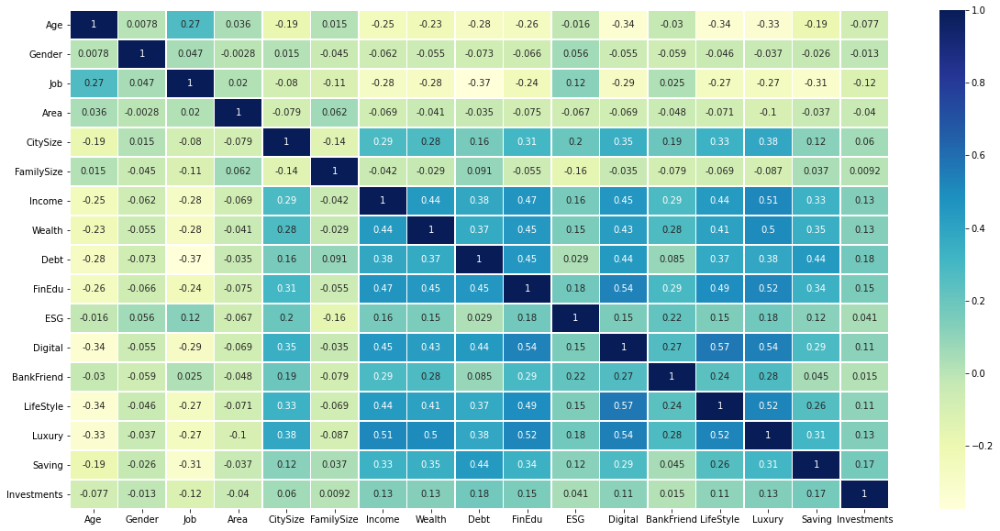

In [ ]:
fig, ax = plt.subplots(figsize=(20,10))
_ = sns.heatmap(raw.corr(), annot=True, cmap="YlGnBu", linewidths=.5, ax=ax)
plt.show()

As we can notice from the heatmap, the highest correlation is 0.57 between "Digital" and "LifeStyle". There is no high correlation between variables and for this reason we can consider all of them.

## DATAFRAMES
Let's now define all the dataframes useful for our analysis:

* **X_readable** : this dataframe is the most readable one since it has no dummy variables inside, no categorical variables represented by numbers (only by words). It will be used to better understand the meaning of the plotted graphical representations

* **X_gower** : this dataframe will be used by the t-SNE algorithm to exploit the Gower Distance

* **X_extended** : this dataframe will be used to train the autoencoder, so, the more observations we have the better it is

* **X** : this dataframe will be used for the majority of the analysis (from dimensionality reduction techniques to clustering algorithms)


### X_readable

In [ ]:
X_readable = raw.copy()
X_readable['Gender'] = X_readable['Gender'].map({0:'Male', 1:'Female'})
X_readable['Job'] = X_readable['Job'].map({1:'Non Occupato', 2:'Impiegato/Operaio', 3:'Quadro/Dirigente', 4:'Imprenditore/Libero professionista', 5:'Pensionato'})
X_readable['Area'] = X_readable['Area'].map({1:'Nord', 2:'Centro', 3:'Sud/Isole'})
X_readable['CitySize'] = X_readable['CitySize'].map({1:'Piccolo Centro', 2:'Cittadina Medie Dimensioni', 3:'Grande Città > 200k'})
X_readable['Investments'] = X_readable['Investments'].map({1:'No Investments', 2:'Mostly Lump Sum', 3:'Mostly Capital Accumulation'})
X_readable = X_readable.sample(n=1950, random_state=SEED)
X_readable

,Age,Gender,Job,Area,CitySize,FamilySize,Income,Wealth,Debt,FinEdu,ESG,Digital,BankFriend,LifeStyle,Luxury,Saving,Investments
2706,30,Male,Impiegato/Operaio,Sud/Isole,Grande Città > 200k,4,0.565737,0.617555,0.448836,0.526744,0.554368,0.563721,0.699880,0.483005,0.714060,0.557289,No Investments
2436,74,Female,Non Occupato,Centro,Cittadina Medie Dimensioni,1,0.763550,0.640984,0.020993,0.344875,0.646110,0.104070,0.233045,0.134825,0.382486,0.677586,Mostly Capital Accumulation
1201,78,Female,Non Occupato,Sud/Isole,Piccolo Centro,4,0.364590,0.258558,0.006518,0.315388,0.443810,0.324103,0.577493,0.215618,0.061133,0.097702,Mostly Capital Accumulation
1486,68,Female,Impiegato/Operaio,Nord,Piccolo Centro,5,0.767256,0.635161,0.664511,0.702884,0.718454,0.927261,0.499640,0.764871,0.312794,0.484662,No Investments
4286,87,Male,Pensionato,Nord,Cittadina Medie Dimensioni,3,0.171376,0.536306,0.303399,0.230860,0.599247,0.379876,0.688877,0.279700,0.187572,0.312886,No Investments
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37,70,Male,Non Occupato,Nord,Cittadina Medie Dimensioni,1,0.086423,0.844713,0.143022,0.342294,0.638884,0.232169,0.691249,0.342064,0.252786,0.416871,Mostly Lump Sum
3990,31,Male,Impiegato/Operaio,Nord,Grande Città > 200k,3,0.939588,0.916069,0.858048,0.710200,0.767007,0.864887,0.875001,0.811824,0.809750,0.585367,Mostly Lump Sum
3207,46,Female,Impiegato/Operaio,Nord,Cittadina Medie Dimensioni,4,0.804297,0.679363,0.539009,0.842045,0.821027,0.890420,0.868116,0.661974,0.758773,0.802968,Mostly Capital Accumulation
2764,89,Female,Impiegato/Operaio,Nord,Piccolo Centro,5,0.312381,0.533710,0.268726,0.595773,0.365492,0.241170,0.760452,0.204501,0.477301,0.616622,Mostly Lump Sum


### X_gower

In [ ]:
X_gower = raw.copy()
X_gower = X_gower.sample(n=1950, random_state=SEED)
X_gower

,Age,Gender,Job,Area,CitySize,FamilySize,Income,Wealth,Debt,FinEdu,ESG,Digital,BankFriend,LifeStyle,Luxury,Saving,Investments
2706,30,0,2,3,3,4,0.565737,0.617555,0.448836,0.526744,0.554368,0.563721,0.699880,0.483005,0.714060,0.557289,1
2436,74,1,1,2,2,1,0.763550,0.640984,0.020993,0.344875,0.646110,0.104070,0.233045,0.134825,0.382486,0.677586,3
1201,78,1,1,3,1,4,0.364590,0.258558,0.006518,0.315388,0.443810,0.324103,0.577493,0.215618,0.061133,0.097702,3
1486,68,1,2,1,1,5,0.767256,0.635161,0.664511,0.702884,0.718454,0.927261,0.499640,0.764871,0.312794,0.484662,1
4286,87,0,5,1,2,3,0.171376,0.536306,0.303399,0.230860,0.599247,0.379876,0.688877,0.279700,0.187572,0.312886,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37,70,0,1,1,2,1,0.086423,0.844713,0.143022,0.342294,0.638884,0.232169,0.691249,0.342064,0.252786,0.416871,2
3990,31,0,2,1,3,3,0.939588,0.916069,0.858048,0.710200,0.767007,0.864887,0.875001,0.811824,0.809750,0.585367,2
3207,46,1,2,1,2,4,0.804297,0.679363,0.539009,0.842045,0.821027,0.890420,0.868116,0.661974,0.758773,0.802968,3
2764,89,1,2,1,1,5,0.312381,0.533710,0.268726,0.595773,0.365492,0.241170,0.760452,0.204501,0.477301,0.616622,2


### X_extended & X

In [ ]:
# normalization
min_max_scaler = preprocessing.MinMaxScaler()
X_extended = raw.copy()
X_extended[["Age", "FamilySize"]] = min_max_scaler.fit_transform(X_extended[["Age", "FamilySize"]])

# one-hot encoding
X_extended['Gender'] = X_extended['Gender'].map({0:1, 1:0}) # per essere precisi i valori di 'Gender', su Matlab, erano stati invertiti

X_extended = pd.concat([X_extended, pd.get_dummies(X_extended.Job).drop(labels=[5], axis=1).rename(columns={1:'Job_1', 2:'Job_2', 3:'Job_3', 4:'Job_4'})], axis=1).drop(labels=['Job'], axis=1)

X_extended = pd.concat([X_extended, pd.get_dummies(X_extended.Area).drop(labels=[3], axis=1).rename(columns={1:'Area_1', 2:'Area_2'})], axis=1).drop(labels=['Area'], axis=1)

X_extended = pd.concat([X_extended, pd.get_dummies(X_extended.CitySize).drop(labels=[3], axis=1).rename(columns={1:'CitySize_1', 2:'CitySize_2'})], axis=1).drop(labels=['CitySize'], axis=1)

X_extended = pd.concat([X_extended, pd.get_dummies(X_extended.Investments).drop(labels=[3], axis=1).rename(columns={1:'Investments_1', 2:'Investments_2'})], axis=1).drop(labels=['Investments'], axis=1)

# column reordering
cols = X_extended.columns.to_list()
cols = cols[1:2] + cols[13:] + cols[0:1] + cols[2:13]
X_extended = X_extended[cols]
X_extended = X_extended.astype({'Gender': 'uint8'}) # trasfromo 'Gender' da int64 a uint8 solo per uniformità finale (in questo modo sono tutte uint8)
X_extended.dtypes
print("\n\n")
X_extended

# sub-sampling
X = X_extended.copy().sample(n=1950, random_state=SEED)
X

Gender             uint8
Job_1              uint8
Job_2              uint8
Job_3              uint8
Job_4              uint8
Area_1             uint8
Area_2             uint8
CitySize_1         uint8
CitySize_2         uint8
Investments_1      uint8
Investments_2      uint8
Age              float64
FamilySize       float64
Income           float64
Wealth           float64
Debt             float64
FinEdu           float64
ESG              float64
Digital          float64
BankFriend       float64
LifeStyle        float64
Luxury           float64
Saving           float64
dtype: object

,Gender,Job_1,Job_2,Job_3,Job_4,Area_1,Area_2,CitySize_1,CitySize_2,Investments_1,Investments_2,Age,FamilySize,Income,Wealth,Debt,FinEdu,ESG,Digital,BankFriend,LifeStyle,Luxury,Saving
0,0,1,0,0,0,0,1,0,1,1,0,0.065789,0.6,0.668046,0.702786,0.262070,0.741853,0.483684,0.698625,0.618259,0.607877,0.897369,0.283222
1,0,0,1,0,0,0,1,0,0,0,0,0.368421,0.0,0.858453,0.915043,0.730430,0.859423,0.537167,0.959025,0.785936,0.862271,0.913729,0.821590
2,1,0,1,0,0,1,0,0,1,0,0,0.250000,0.2,0.926818,0.898316,0.441272,0.485953,0.649434,0.750265,0.699725,0.755404,0.765199,0.503790
3,1,0,1,0,0,1,0,0,1,0,1,0.631579,0.4,0.538797,0.423180,0.600401,0.493144,0.533829,0.590165,0.675353,0.334432,0.517209,0.691240
4,1,0,1,0,0,1,0,0,0,0,1,0.184211,0.0,0.806659,0.731404,0.831449,0.856286,0.784940,0.710026,0.758793,0.908878,0.611610,0.615916
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,0,0,0,1,0,1,0,0,0,0,0,0.447368,0.2,0.885471,0.534661,0.770399,0.746182,0.765611,0.823639,0.543243,0.801524,0.636120,0.776405
4996,0,0,0,0,0,1,0,1,0,0,1,0.934211,0.6,0.655382,0.271317,0.114485,0.421563,0.591364,0.609389,0.677272,0.387290,0.481525,0.208846
4997,0,0,1,0,0,1,0,0,0,0,0,0.763158,0.0,0.698357,0.833386,0.292712,0.277196,0.864571,0.706673,0.688205,0.736855,0.476645,0.449406
4998,1,0,1,0,0,1,0,0,1,0,0,0.855263,0.2,0.898275,0.827659,0.403069,0.652992,0.768886,0.795571,0.746251,0.532479,0.891367,0.641447


,Gender,Job_1,Job_2,Job_3,Job_4,Area_1,Area_2,CitySize_1,CitySize_2,Investments_1,Investments_2,Age,FamilySize,Income,Wealth,Debt,FinEdu,ESG,Digital,BankFriend,LifeStyle,Luxury,Saving
2706,1,0,1,0,0,0,0,0,0,1,0,0.144737,0.6,0.565737,0.617555,0.448836,0.526744,0.554368,0.563721,0.699880,0.483005,0.714060,0.557289
2436,0,1,0,0,0,0,1,0,1,0,0,0.723684,0.0,0.763550,0.640984,0.020993,0.344875,0.646110,0.104070,0.233045,0.134825,0.382486,0.677586
1201,0,1,0,0,0,0,0,1,0,0,0,0.776316,0.6,0.364590,0.258558,0.006518,0.315388,0.443810,0.324103,0.577493,0.215618,0.061133,0.097702
1486,0,0,1,0,0,1,0,1,0,1,0,0.644737,0.8,0.767256,0.635161,0.664511,0.702884,0.718454,0.927261,0.499640,0.764871,0.312794,0.484662
4286,1,0,0,0,0,1,0,0,1,1,0,0.894737,0.4,0.171376,0.536306,0.303399,0.230860,0.599247,0.379876,0.688877,0.279700,0.187572,0.312886
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37,1,1,0,0,0,1,0,0,1,0,1,0.671053,0.0,0.086423,0.844713,0.143022,0.342294,0.638884,0.232169,0.691249,0.342064,0.252786,0.416871
3990,1,0,1,0,0,1,0,0,0,0,1,0.157895,0.4,0.939588,0.916069,0.858048,0.710200,0.767007,0.864887,0.875001,0.811824,0.809750,0.585367
3207,0,0,1,0,0,1,0,0,1,0,0,0.355263,0.6,0.804297,0.679363,0.539009,0.842045,0.821027,0.890420,0.868116,0.661974,0.758773,0.802968
2764,0,0,1,0,0,1,0,1,0,0,1,0.921053,0.8,0.312381,0.533710,0.268726,0.595773,0.365492,0.241170,0.760452,0.204501,0.477301,0.616622


# DIMENSIONALITY REDUCTION TECHNIQUES
We used 4 techniques to visualize the dataset:

* t-SNE
* PCA
* ICA
* Autoencoder

## t-SNE

### Mix Distance
Since t-SNE is based on distance calculations, let's define a custom distance function 

In [ ]:
def mix_distance(X):
    n_num, n_cat = X.dtypes.value_counts()
    
    d_cat = pairwise_distances(X.iloc[:, 0:n_cat], metric = "hamming")
    d_num = pairwise_distances(X.iloc[:, n_cat:], metric = "cityblock")
    w_cat = n_cat/(n_cat+n_num)
    
    return w_cat*d_cat + (1-w_cat)*d_num

### Implementation
Since t-SNE is resource and time consuming, I decided to save the NumPy arrays obtained by the actual execution of the algorithm. If the file containing the arrays are already in the DATA_FOLDER they can be directly uploaded in main memory.

In [ ]:
TSNE_FOLDER = os.path.join(DATA_FOLDER, 'tsne-results')

# cosine
if os.path.isfile(os.path.join(TSNE_FOLDER, 'tsne_results_cosine.npy')):
    tsne_results_cosine = np.load(os.path.join(TSNE_FOLDER, 'tsne_results_cosine.npy'))
else:
    tsne = TSNE(metric="cosine", method='exact')
    tsne_results_cosine = tsne.fit_transform(X)
    np.save(os.path.join(TSNE_FOLDER, 'tsne_results_cosine'), tsne_results_cosine)

# cityblock
if os.path.isfile(os.path.join(TSNE_FOLDER, 'tsne_results_cityblock.npy')):
    tsne_results_cityblock = np.load(os.path.join(TSNE_FOLDER, 'tsne_results_cityblock.npy'))
else:
    tsne = TSNE(metric="cityblock", method='exact')
    tsne_results_cityblock = tsne.fit_transform(X)
    np.save(os.path.join(TSNE_FOLDER, 'tsne_results_cityblock'), tsne_results_cityblock)

# euclidean
if os.path.isfile(os.path.join(TSNE_FOLDER, 'tsne_results_euclidean.npy')):
    tsne_results_euclidean = np.load(os.path.join(TSNE_FOLDER, 'tsne_results_euclidean.npy'))
else:
    tsne = TSNE(method='exact')
    tsne_results_euclidean = tsne.fit_transform(X)
    np.save(os.path.join(TSNE_FOLDER, 'tsne_results_euclidean'), tsne_results_euclidean)

# mix distance
if os.path.isfile(os.path.join(TSNE_FOLDER, 'tsne_results_mix.npy')):
    tsne_results_mix = np.load(os.path.join(TSNE_FOLDER, 'tsne_results_mix.npy'))
else:
    tsne = TSNE(metric="precomputed", method='exact')
    tsne_results_mix = tsne.fit_transform(mix_distance(X))
    np.save(os.path.join(TSNE_FOLDER, 'tsne_results_mix'), tsne_results_mix)

# gower distance
if os.path.isfile(os.path.join(TSNE_FOLDER, 'tsne_results_gower.npy')):
    tsne_results_gower = np.load(os.path.join(TSNE_FOLDER, 'tsne_results_gower.npy'))
else:
    tsne = TSNE(metric="precomputed", method='exact')
    tsne_results_gower = tsne.fit_transform(gower.gower_matrix(X_gower))
    np.save(os.path.join(TSNE_FOLDER, 'tsne_results_gower'), tsne_results_gower)

Let's plot the 5 representations of the obtained results.

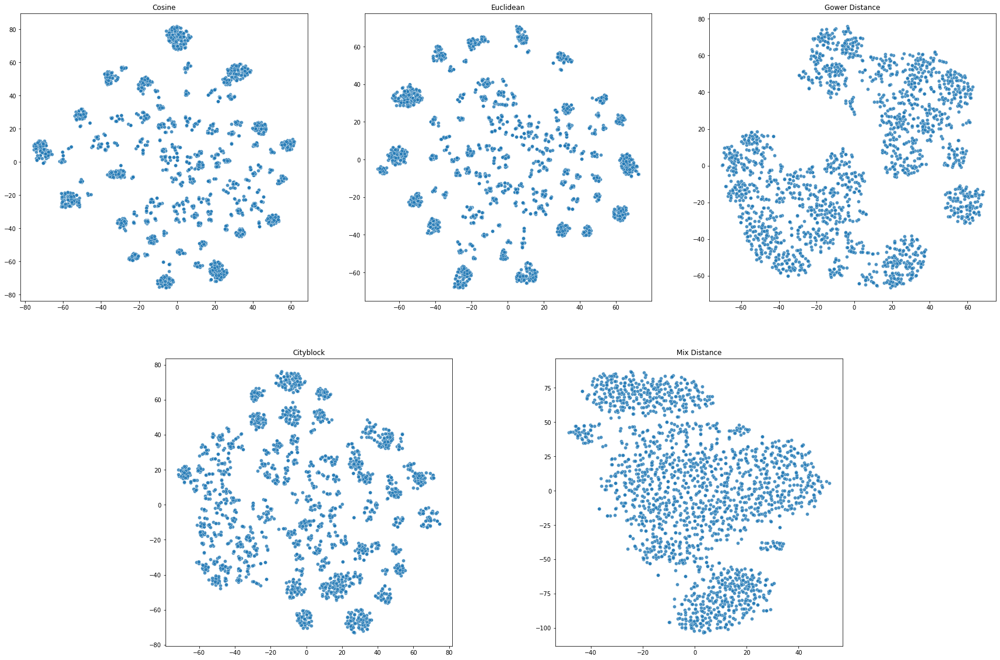

In [ ]:
fig, axs = plt.subplots(2,3, figsize=(30,20))
_ = axs[1][2].set_visible(False)

_ = axs[1][0].set_position([0.24,0.125,0.228,0.343])
_ = axs[1][1].set_position([0.55,0.125,0.228,0.343])

_ = axs[0][0].set_title('Cosine')
_ = sns.scatterplot(
    x=tsne_results_cosine[:,0], y=tsne_results_cosine[:,1],
    alpha=0.8,
    ax=axs[0][0]
)
_ = axs[1][0].set_title('Cityblock')
_ = sns.scatterplot(
    x=tsne_results_cityblock[:,0], y=tsne_results_cityblock[:,1],
    alpha=0.8,
    ax=axs[1][0]
)
_ = axs[0][1].set_title('Euclidean')
_ = sns.scatterplot(
    x=tsne_results_euclidean[:,0], y=tsne_results_euclidean[:,1],
    alpha=0.8,
    ax=axs[0][1]
)
_ = axs[1][1].set_title('Mix Distance')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    ax=axs[1][1]
)
_ = axs[0][2].set_title('Gower Distance')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    ax=axs[0][2]
)

From now on, we will only consider the plots related to Mix Distance and Gower Distance. This due to the fact using other distances is wrong from a theoretical standpoint and it is also difficult to recognize clusters inside the associated representations.

## PCA

In [ ]:
pca = PCA(n_components=3)
pca_result = pca.fit_transform(X)

print('Explained variation per principal component: {}'.format(pca.explained_variance_ratio_))

Explained variation per principal component: [0.15871242 0.14845732 0.12296793]


As we can notice from the parameter printed above, with PCA we are able to maintain 0.1587 + 0.1484 + 0.1229 = 0.43 = 43% of the information.

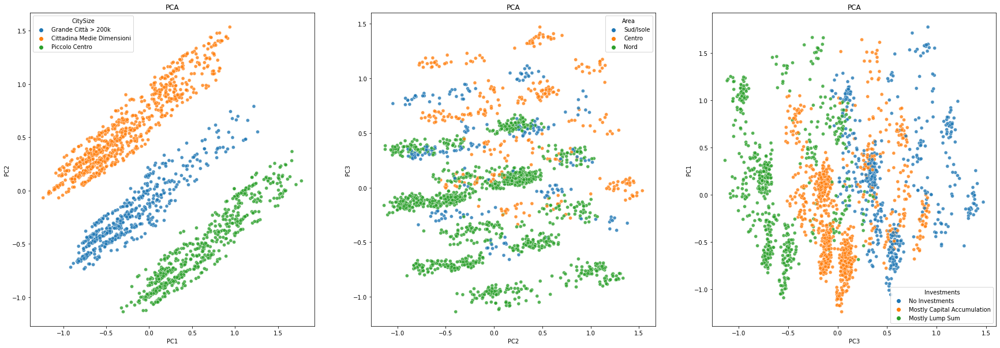

In [ ]:
fig, axs = plt.subplots(1,3, figsize=(30,10))

_ = axs[0].set_title('PCA')
_ = sns.scatterplot(
    x=pca_result[:,0], y=pca_result[:,1],
    alpha=0.8,
    hue='CitySize',
    data=X_readable,
    ax=axs[0]
)
_ = axs[0].set_xlabel('PC1')
_ = axs[0].set_ylabel('PC2')

_ = axs[1].set_title('PCA')
_ = sns.scatterplot(
    x=pca_result[:,1], y=pca_result[:,2],
    alpha=0.8,
    hue='Area',
    data=X_readable,
    ax=axs[1]
)
_ = axs[1].set_xlabel('PC2')
_ = axs[1].set_ylabel('PC3')

_ = axs[2].set_title('PCA')
_ = sns.scatterplot(
    x=pca_result[:,2], y=pca_result[:,0],
    alpha=0.8,
    hue='Investments',
    data=X_readable,
    ax=axs[2]
)
_ = axs[2].set_xlabel('PC3')
_ = axs[2].set_ylabel('PC1')

## ICA

In [ ]:
ica = FastICA(n_components=3, random_state=SEED)
ica_result = ica.fit_transform(X)

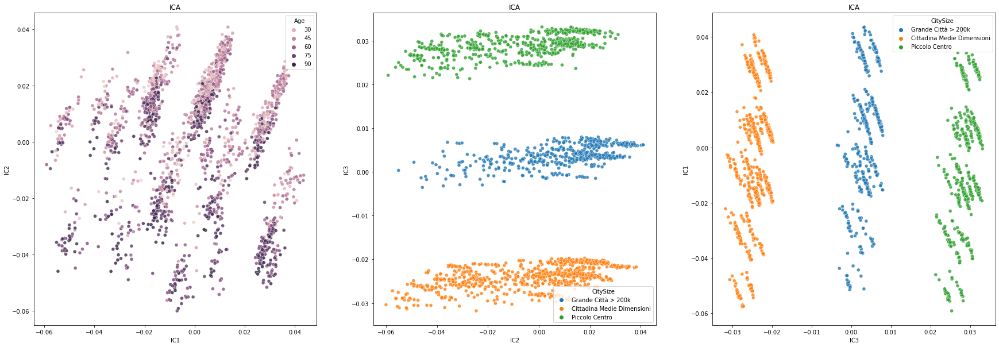

In [ ]:
fig, axs = plt.subplots(1,3, figsize=(30,10))

_ = axs[0].set_title('ICA')
_ = sns.scatterplot(
    x=ica_result[:,0], y=ica_result[:,1],
    alpha=0.8,
    hue='Age',
    data=X_readable,
    ax=axs[0]
)
_ = axs[0].set_xlabel('IC1')
_ = axs[0].set_ylabel('IC2')

_ = axs[1].set_title('ICA')
_ = sns.scatterplot(
    x=ica_result[:,1], y=ica_result[:,2],
    alpha=0.8,
    hue='CitySize',
    data=X_readable,
    ax=axs[1]
)
_ = axs[1].set_xlabel('IC2')
_ = axs[1].set_ylabel('IC3')

_ = axs[2].set_title('ICA')
_ = sns.scatterplot(
    x=ica_result[:,2], y=ica_result[:,0],
    alpha=0.8,
    hue='CitySize',
    data=X_readable,
    ax=axs[2]
)
_ = axs[2].set_xlabel('IC3')
_ = axs[2].set_ylabel('IC1')

## AUTOENCODER

In [ ]:
n_inputs = 23
n_hidden =  
n_outputs = n_inputs

x_train = X_extended.head(4000).to_numpy().astype('float32')
x_test = X_extended.tail(1000).to_numpy().astype('float32')

In [ ]:
encoder = Sequential([Dense(n_hidden, input_shape=[n_inputs])])

decoder = Sequential([Dense(n_outputs, input_shape=[n_hidden])])

autoencoder = Sequential([encoder, decoder])

autoencoder.compile(loss='mse', optimizer=keras.optimizers.SGD(learning_rate=0.1))

In [ ]:
autoencoder.fit(x_train, x_train, epochs=30, batch_size=16, shuffle=False, validation_data=(x_test, x_test))

Epoch 1/30
250/250 [==============================] - 3s 3ms/step - loss: 0.1398 - val_loss: 0.0943
Epoch 2/30
250/250 [==============================] - 1s 2ms/step - loss: 0.0885 - val_loss: 0.0843
Epoch 3/30
250/250 [==============================] - 1s 2ms/step - loss: 0.0804 - val_loss: 0.0780
Epoch 4/30
250/250 [==============================] - 1s 2ms/step - loss: 0.0754 - val_loss: 0.0740
Epoch 5/30
250/250 [==============================] - 1s 2ms/step - loss: 0.0721 - val_loss: 0.0712
Epoch 6/30
250/250 [==============================] - 0s 2ms/step - loss: 0.0696 - val_loss: 0.0691
Epoch 7/30
250/250 [==============================] - 0s 2ms/step - loss: 0.0677 - val_loss: 0.0674
Epoch 8/30
250/250 [==============================] - 0s 2ms/step - loss: 0.0662 - val_loss: 0.0661
Epoch 9/30
250/250 [==============================] - 1s 2ms/step - loss: 0.0650 - val_loss: 0.0650
Epoch 10/30
250/250 [==============================] - 0s 2ms/step - loss: 0.0640 - val_loss: 0.0642

array([[ 1.8197882 ,  0.25529546, -0.01343246],
       [-0.03482455,  0.9908033 ,  0.85317   ],
       [ 0.28366476,  0.38744873, -0.56009185],
       ...,
       [ 1.1070422 , -0.40277576,  0.8294113 ],
       [ 0.9773005 , -0.77139866, -0.7090024 ],
       [ 0.4385454 , -0.15405622,  0.81175077]], dtype=float32)

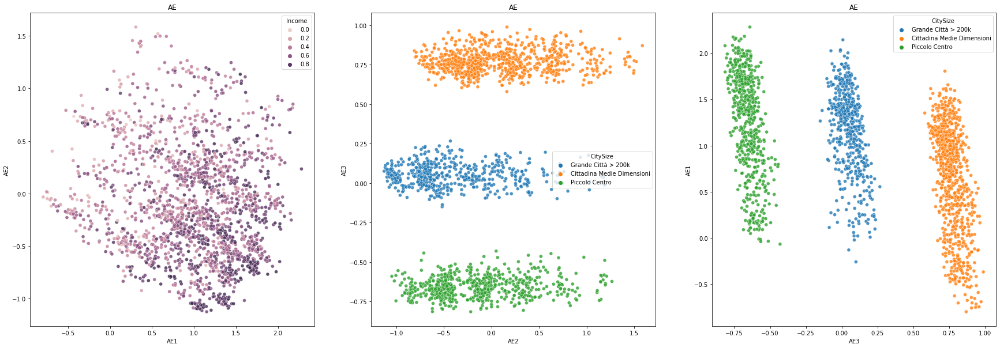

In [ ]:
encoded_data = encoder.predict(X)
encoded_data
print("\n\n")

fig, axs = plt.subplots(1,3, figsize=(30,10))

_ = axs[0].set_title('AE')
_ = sns.scatterplot(
    x=encoded_data[:,0], y=encoded_data[:,1],
    alpha=0.8,
    hue='Income',
    data=X_readable,
    ax=axs[0]
)
_ = axs[0].set_xlabel('AE1')
_ = axs[0].set_ylabel('AE2')

_ = axs[1].set_title('AE')
_ = sns.scatterplot(
    x=encoded_data[:,1], y=encoded_data[:,2],
    alpha=0.8,
    hue='CitySize',
    data=X_readable,
    ax=axs[1]
)
_ = axs[1].set_xlabel('AE2')
_ = axs[1].set_ylabel('AE3')

_ = axs[2].set_title('AE')
_ = sns.scatterplot(
    x=encoded_data[:,2], y=encoded_data[:,0],
    alpha=0.8,
    hue='CitySize',
    data=X_readable,
    ax=axs[2]
)
_ = axs[2].set_xlabel('AE3')
_ = axs[2].set_ylabel('AE1')

# COMPARISONS & ANALYSIS
Let's make some comparisons between the obtained results.

## PCA vs ICA vs AE

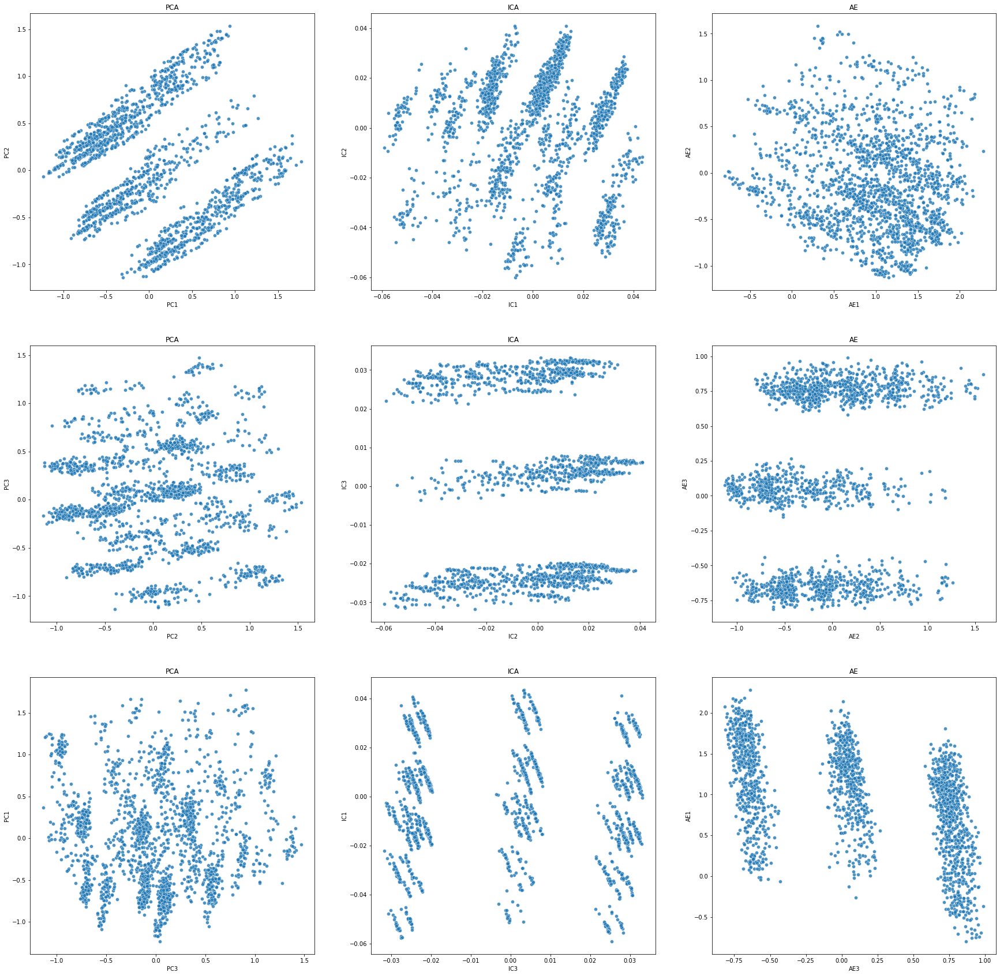

In [ ]:
fig, axs = plt.subplots(3,3, figsize=(30,30))

_ = axs[0][0].set_title('PCA')
_ = sns.scatterplot(
    x=pca_result[:,0], y=pca_result[:,1],
    alpha=0.8,
    ax=axs[0][0]
)
_ = axs[0][0].set_xlabel('PC1')
_ = axs[0][0].set_ylabel('PC2')

_ = axs[0][1].set_title('ICA')
_ = sns.scatterplot(
    x=ica_result[:,0], y=ica_result[:,1],
    alpha=0.8,
    ax=axs[0][1]
)
_ = axs[0][1].set_xlabel('IC1')
_ = axs[0][1].set_ylabel('IC2')

_ = axs[0][2].set_title('AE')
_ = sns.scatterplot(
    x=encoded_data[:,0], y=encoded_data[:,1],
    alpha=0.8,
    ax=axs[0][2]
)
_ = axs[0][2].set_xlabel('AE1')
_ = axs[0][2].set_ylabel('AE2')

#-------------------------

_ = axs[1][0].set_title('PCA')
_ = sns.scatterplot(
    x=pca_result[:,1], y=pca_result[:,2],
    alpha=0.8,
    ax=axs[1][0]
)
_ = axs[1][0].set_xlabel('PC2')
_ = axs[1][0].set_ylabel('PC3')

_ = axs[1][1].set_title('ICA')
_ = sns.scatterplot(
    x=ica_result[:,1], y=ica_result[:,2],
    alpha=0.8,
    ax=axs[1][1]
)
_ = axs[1][1].set_xlabel('IC2')
_ = axs[1][1].set_ylabel('IC3')

_ = axs[1][2].set_title('AE')
_ = sns.scatterplot(
    x=encoded_data[:,1], y=encoded_data[:,2],
    alpha=0.8,
    ax=axs[1][2]
)
_ = axs[1][2].set_xlabel('AE2')
_ = axs[1][2].set_ylabel('AE3')

#-------------------------

_ = axs[2][0].set_title('PCA')
_ = sns.scatterplot(
    x=pca_result[:,2], y=pca_result[:,0],
    alpha=0.8,
    ax=axs[2][0]
)
_ = axs[2][0].set_xlabel('PC3')
_ = axs[2][0].set_ylabel('PC1')

_ = axs[2][1].set_title('ICA')
_ = sns.scatterplot(
    x=ica_result[:,2], y=ica_result[:,0],
    alpha=0.8,
    ax=axs[2][1]
)
_ = axs[2][1].set_xlabel('IC3')
_ = axs[2][1].set_ylabel('IC1')

_ = axs[2][2].set_title('AE')
_ = sns.scatterplot(
    x=encoded_data[:,2], y=encoded_data[:,0],
    alpha=0.8,
    ax=axs[2][2]
)
_ = axs[2][2].set_xlabel('AE3')
_ = axs[2][2].set_ylabel('AE1')

From the plots above it seems that all the 3 techniques performed the dimensionality reduction task in a similar fashion. Let's analyse deeply some properties of those algorithms.



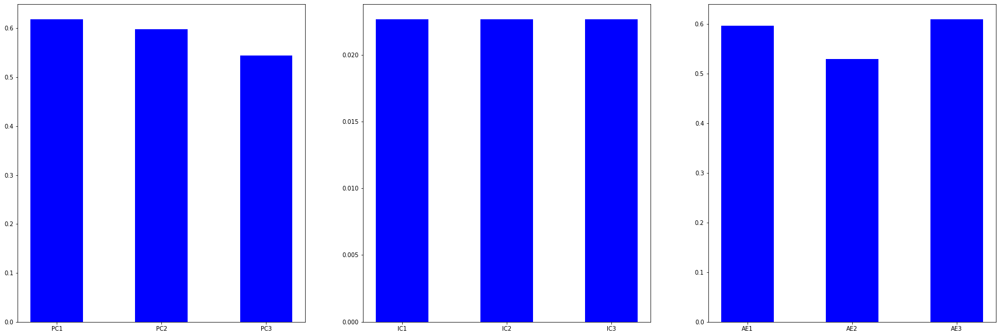

In [ ]:
pca_dic = {'PC1': pca_result[:,0].std(), 'PC2': pca_result[:,1].std(), 'PC3': pca_result[:,2].std()}
ica_dic = {'IC1': ica_result[:,0].std(), 'IC2': ica_result[:,1].std(), 'IC3': ica_result[:,2].std()}
ae_dic = {'AE1': encoded_data[:,0].std(), 'AE2': encoded_data[:,1].std(), 'AE3': encoded_data[:,2].std()}

fig, axs = plt.subplots(1,3, figsize=(30,10))

_ = axs[0].bar(pca_dic.keys(), pca_dic.values(), width=0.5, color='b')
_ = axs[1].bar(ica_dic.keys(), ica_dic.values(), width=0.5, color='b')
_ = axs[2].bar(ae_dic.keys(), ae_dic.values(), width=0.5, color='b')

As we can expect, in the PCA bargraph, the variance decreases with the number of the component it refers to. The same concept is not valid for the plot related to the autoencoder. 

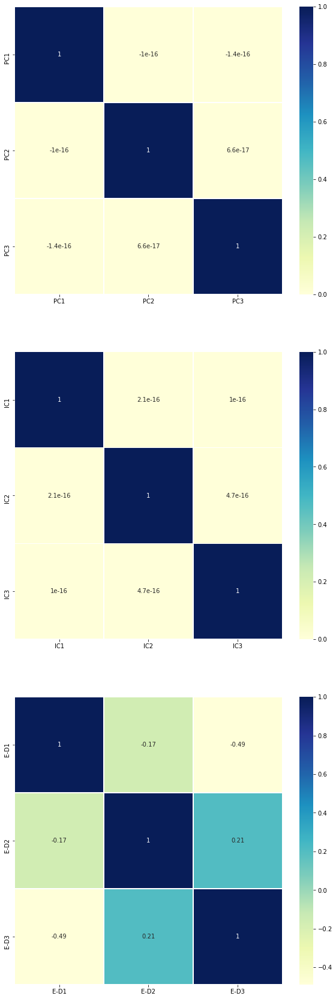

In [ ]:
pca_df = pd.DataFrame(pca_result, columns=['PC1', 'PC2', 'PC3'])
ica_df = pd.DataFrame(ica_result, columns=['IC1', 'IC2', 'IC3'])
ae_df = pd.DataFrame(encoded_data, columns=['E-D1', 'E-D2', 'E-D3'])

fig, axs = plt.subplots(3,1, figsize=(10,30))

_ = sns.heatmap(pca_df.corr(), annot=True, cmap="YlGnBu", linewidths=.5, ax=axs[0])
_ = sns.heatmap(ica_df.corr(), annot=True, cmap="YlGnBu", linewidths=.5, ax=axs[1])
_ = sns.heatmap(ae_df.corr(), annot=True, cmap="YlGnBu", linewidths=.5, ax=axs[2])

plt.show()

From this plot, PCs are orthogonal to each other since they are uncorrelated and the same concept is valid for ICs. In fact we are in front of 2 diagonal matrixes. On the other side, this orthogonality is not valid for the autoencoder components. The matrix shows some correlation between the 3 dimensions.

All the dimensionality reduction techniques loose accuracy. But we can anyway compare the performances of these techniques and understand which is the best of them. To do so, we should have cluster labels for all the observations.

Looking at [this article](https://towardsdatascience.com/dimensionality-reduction-with-autoencoders-versus-pca-f47666f80743) we can notice how PCA usually performs a little bit better w.r.t. AE.

Adding hidden layers and non-linearity (i.e., using activation functions) to the autoencoder makes it more accurate and sometimes even better of the PCA approach.

## t-SNE ANALYSIS
We will analyze some details that can be noticed by looking at the t-SNE plots. Let's take into consideration only the Mix Distance and Gower Distance ones.

### Mix Distance Plots and Deductions

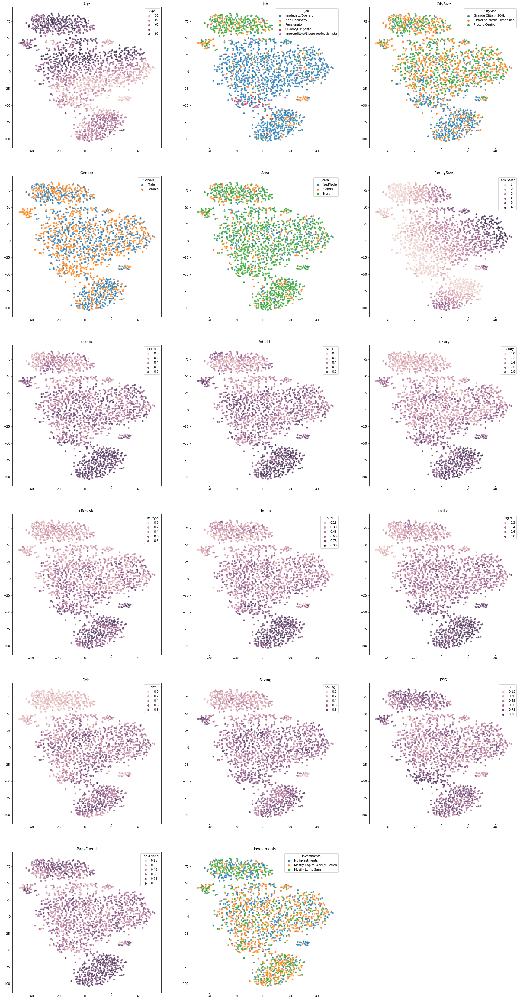

In [ ]:
fig, axs = plt.subplots(6,3, figsize=(30,60))
_ = axs[5][2].set_visible(False)

_ = axs[0][0].set_title('Age')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Age',
    ax=axs[0][0]
)
_ = axs[1][0].set_title('Gender')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Gender',
    ax=axs[1][0]
)
_ = axs[0][1].set_title('Job')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Job',
    ax=axs[0][1]
)
_ = axs[1][1].set_title('Area')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Area',
    ax=axs[1][1]
)
_ = axs[0][2].set_title('CitySize')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=X_readable,
    hue='CitySize',
    ax=axs[0][2]
)
_ = axs[1][2].set_title('FamilySize')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=X_readable,
    hue='FamilySize',
    ax=axs[1][2]
)
_ = axs[2][0].set_title('Income')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Income',
    ax=axs[2][0]
)
_ = axs[2][1].set_title('Wealth')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Wealth',
    ax=axs[2][1]
)
_ = axs[2][2].set_title('Luxury')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Luxury',
    ax=axs[2][2]
)
_ = axs[3][0].set_title('LifeStyle')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=X_readable,
    hue='LifeStyle',
    ax=axs[3][0]
)
_ = axs[3][1].set_title('FinEdu')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=X_readable,
    hue='FinEdu',
    ax=axs[3][1]
)
_ = axs[3][2].set_title('Digital')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Digital',
    ax=axs[3][2]
)
_ = axs[4][0].set_title('Debt')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Debt',
    ax=axs[4][0]
)
_ = axs[4][1].set_title('Saving')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Saving',
    ax=axs[4][1]
)
_ = axs[4][2].set_title('ESG')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=X_readable,
    hue='ESG',
    ax=axs[4][2]
)
_ = axs[5][0].set_title('BankFriend')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=X_readable,
    hue='BankFriend',
    ax=axs[5][0]
)
_ = axs[5][1].set_title('Investments')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Investments',
    ax=axs[5][1]
)

**ATTENTION!!!** Non aprire la cella per modificare che "crasha" essendoci l'immagine inserita all'interno.

DEDUCTIONS from the MIX DISTANCE PLOTS ([here](https://drive.google.com/file/d/1IjVaErBS7j1uqkyKIm2vImzH9MxgrMwo/view?usp=sharing) the link for the image in case it cannot be opened from the Notebook):

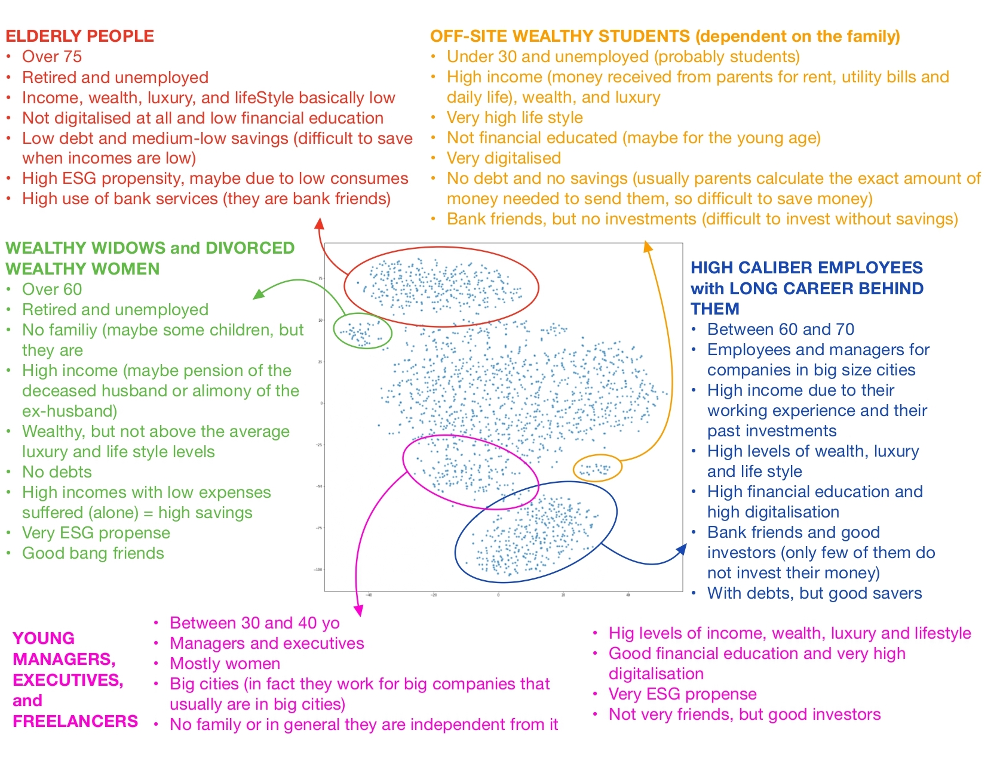

### Gower Distance Plots and Deductions

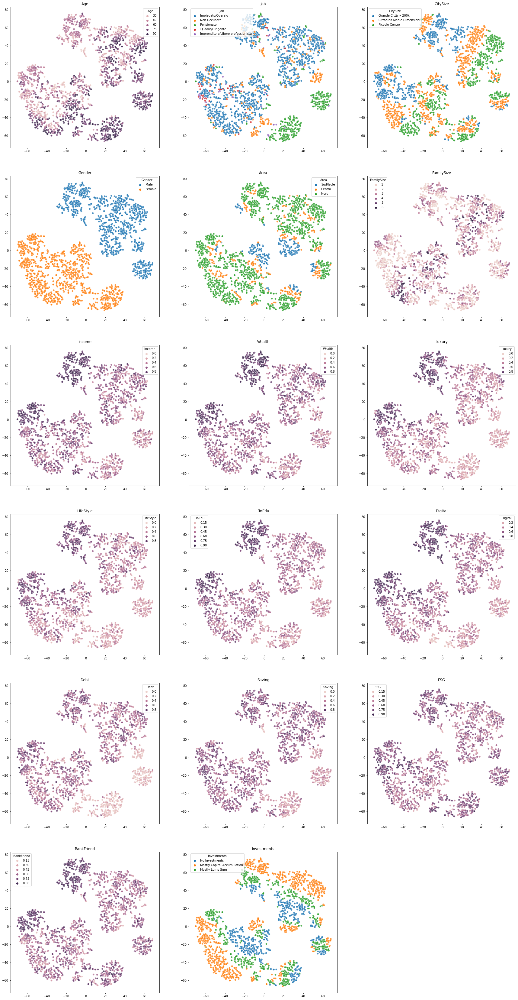

In [ ]:
fig, axs = plt.subplots(6,3, figsize=(30,60))
_ = axs[5][2].set_visible(False)

_ = axs[0][0].set_title('Age')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Age',
    ax=axs[0][0]
)
_ = axs[1][0].set_title('Gender')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Gender',
    ax=axs[1][0]
)
_ = axs[0][1].set_title('Job')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Job',
    ax=axs[0][1]
)
_ = axs[1][1].set_title('Area')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Area',
    ax=axs[1][1]
)
_ = axs[0][2].set_title('CitySize')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=X_readable,
    hue='CitySize',
    ax=axs[0][2]
)
_ = axs[1][2].set_title('FamilySize')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=X_readable,
    hue='FamilySize',
    ax=axs[1][2]
)
_ = axs[2][0].set_title('Income')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Income',
    ax=axs[2][0]
)
_ = axs[2][1].set_title('Wealth')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Wealth',
    ax=axs[2][1]
)
_ = axs[2][2].set_title('Luxury')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Luxury',
    ax=axs[2][2]
)
_ = axs[3][0].set_title('LifeStyle')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=X_readable,
    hue='LifeStyle',
    ax=axs[3][0]
)
_ = axs[3][1].set_title('FinEdu')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=X_readable,
    hue='FinEdu',
    ax=axs[3][1]
)
_ = axs[3][2].set_title('Digital')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Digital',
    ax=axs[3][2]
)
_ = axs[4][0].set_title('Debt')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Debt',
    ax=axs[4][0]
)
_ = axs[4][1].set_title('Saving')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Saving',
    ax=axs[4][1]
)
_ = axs[4][2].set_title('ESG')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=X_readable,
    hue='ESG',
    ax=axs[4][2]
)
_ = axs[5][0].set_title('BankFriend')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=X_readable,
    hue='BankFriend',
    ax=axs[5][0]
)
_ = axs[5][1].set_title('Investments')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=X_readable,
    hue='Investments',
    ax=axs[5][1]
)

**ATTENTION!!!** Non aprire la cella per modificare che "crasha" essendoci l'immagine inserita all'interno.

DEDUCTIONS from the GOWER DISTANCE PLOTS ([here](https://drive.google.com/file/d/1r7sl6_Tps_wewLhaVzNtNmYNfuMKAp-s/view?usp=sharing) the link for the image in case it cannot be opened from the Notebook):

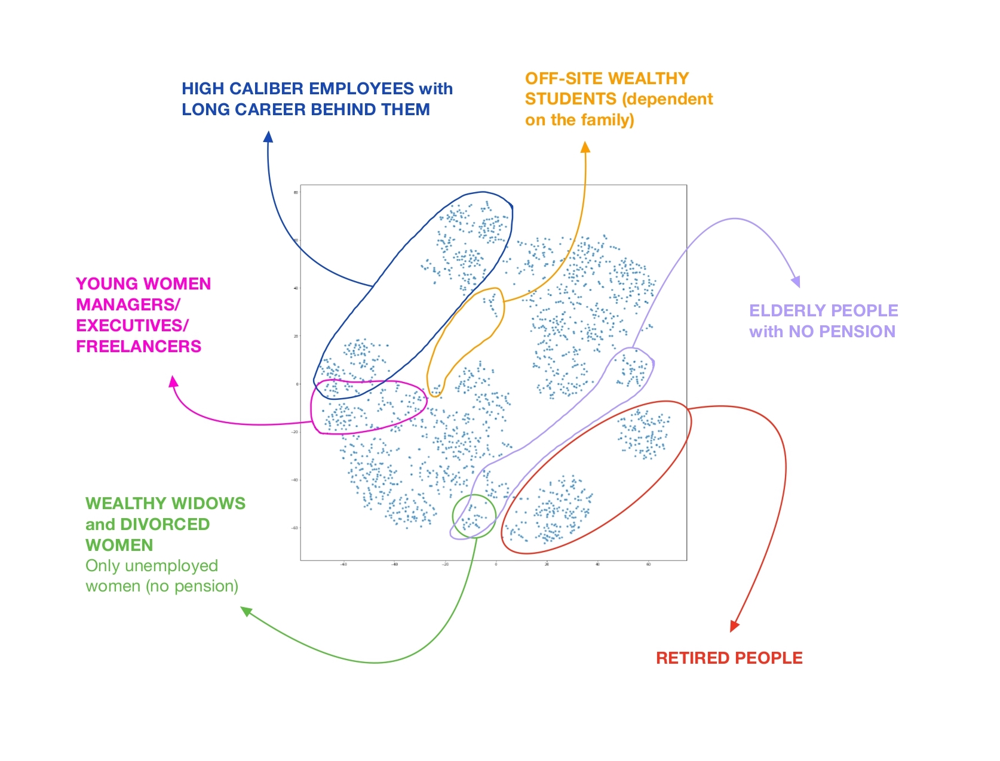

### General deductions

* There are more customers from Northern areas. This could have 2 causes:

  * This bank works more in the Northern areas
  * Northern people is more "banked" than Southern ones

* Find clusters from the t-SNE representations obtained with Gower Distance could be less intuitive than ecxtract them from the Mix Distance plots
* The "Quadro/Dirigente" category is composed mostly by women
* The highest incomes are not only perceived from "Quadro/Dirigente" and "Imprenditore/Libero Professionista", but also from a specific slice of "Impiegato/Operaio".  

# CLUSTERING

This is the section dedicated to clustering algorithms. Let's divide this section into 2 parts:

1. Clustering with Mix Distance
2. Clustering with Gower Distance


## MIX DISTANCE CLUSTERING

### K-Medoids Clustering 

K-Medoids is a clustering algorithm resembling the K-Means clustering technique. It falls under the category of unsupervised machine learning. It majorly differs from the K-Means algorithm in terms of the way it selects the clusters’ centers. The former selects the average of a cluster’s points as its center while the latter always picks the actual data points from the clusters as their centers . K-Medoids also differs in this respect from the K-Medians algorithm which, is the same as K-means, except that it chooses the medians of the clusters as centers.

More detail [here](https://analyticsindiamag.com/comprehensive-guide-to-k-medoids-clustering-algorithm/).

In particular we use sklearn_extra library of python.
More detail [here](https://scikit-learn-extra.readthedocs.io/en/latest/generated/sklearn_extra.cluster.KMedoids.html).

In [ ]:
kmedoids_results = []

for i in range(2, 10):
    kmedoids = KMedoids(n_clusters=i, metric='precomputed', method='pam', max_iter=20, random_state=SEED).fit(mix_distance(X))
    kmedoids_results.append(kmedoids)
    print("KMedoids with " + str(i) + " cluster inertia: " + str(kmedoids.inertia_))

KMedoids with 2 cluster inertia: 2255.9298795258496
KMedoids with 3 cluster inertia: 2035.5502896690837
KMedoids with 4 cluster inertia: 1949.4012486809488
KMedoids with 5 cluster inertia: 1899.6480576545252
KMedoids with 6 cluster inertia: 1871.5958052335293
KMedoids with 7 cluster inertia: 1836.7116899407722
KMedoids with 8 cluster inertia: 1801.104630036748
KMedoids with 9 cluster inertia: 1775.7055073173342


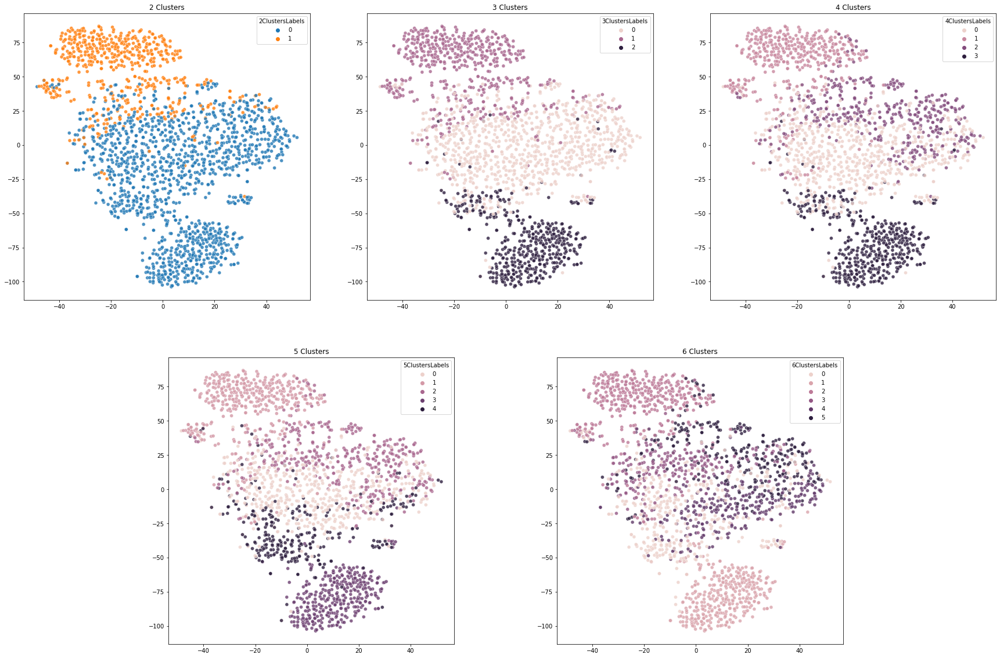

In [ ]:
Y = X_readable.copy()
Y['2ClustersLabels'] = kmedoids_results[0].labels_
Y['3ClustersLabels'] = kmedoids_results[1].labels_
Y['4ClustersLabels'] = kmedoids_results[2].labels_
Y['5ClustersLabels'] = kmedoids_results[3].labels_
Y['6ClustersLabels'] = kmedoids_results[4].labels_


fig, axs = plt.subplots(2,3, figsize=(30,20))
_ = axs[1][2].set_visible(False)

_ = axs[1][0].set_position([0.24,0.125,0.228,0.343])
_ = axs[1][1].set_position([0.55,0.125,0.228,0.343])

_ = axs[0][0].set_title('2 Clusters')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=Y,
    hue='2ClustersLabels',
    ax=axs[0][0]
)
_ = axs[0][1].set_title('3 Clusters')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=Y,
    hue='3ClustersLabels',
    ax=axs[0][1]
)
_ = axs[0][2].set_title('4 Clusters')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=Y,
    hue='4ClustersLabels',
    ax=axs[0][2]
)
_ = axs[1][0].set_title('5 Clusters')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=Y,
    hue='5ClustersLabels',
    ax=axs[1][0]
)
_ = axs[1][1].set_title('6 Clusters')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=Y,
    hue='6ClustersLabels',
    ax=axs[1][1]
)

#### Evaluation


This section is intended to evaluate the best number of clusters.

The evaluation will be carried out with the following methods:

* Elbow rule
* Silhoutte Index
* Calinski-Harabasz Index
* Davies-Bouldin Index

More info at the first part of [this document](https://medium.com/@haataa/how-to-measure-clustering-performances-when-there-are-no-ground-truth-db027e9a871c).

##### Elbow Rule

With this method, looking at the inertia graph, we can roughly estimate the best number of clusters cosidering where the elbow is.

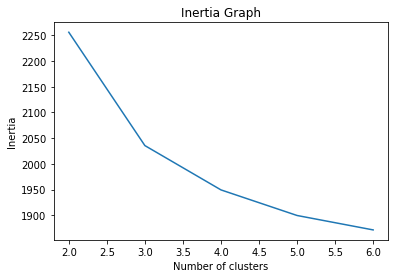

In [ ]:
_ = plt.plot(range(2, 7), [kmedoids.inertia_ for kmedoids in kmedoids_results[:5]])
_ = plt.title('Inertia Graph')
_ = plt.xlabel('Number of clusters')
_ = plt.ylabel('Inertia')    
plt.show()

The elbow seems to be where "number of clusters" = 3. So, a roughly estimation of the best number of clusters could be 3.

##### Silhouette Index

Silhouette analysis can be used to study the separation distance between the resulting clusters. The silhouette plot displays a measure of how close each point in one cluster is to points in the neighboring clusters and thus provides a way to assess parameters like number of clusters visually. This measure has a range of [-1, 1]. More detail [here](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.silhouette_score.html).

In [ ]:
silhouette_scores = []

for i in range(2, 10):
    silhouette_avg = silhouette_score(mix_distance(X), kmedoids_results[i-2].labels_, metric='precomputed')
    print(str(i) + " clusters: " + str(silhouette_avg))
    silhouette_scores.append(silhouette_avg)

2 clusters: 0.21808316154124283
3 clusters: 0.18561114265053733
4 clusters: 0.15466300071404657
5 clusters: 0.14486008610136647
6 clusters: 0.13877845640753403
7 clusters: 0.05902608793388758
8 clusters: 0.05529833263566235
9 clusters: 0.05097571769827297


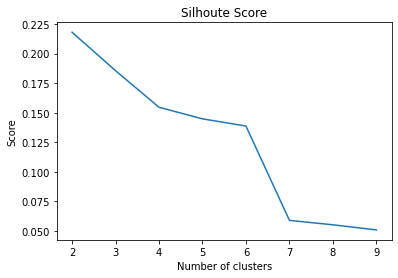

In [ ]:
_ = plt.plot(range(2, 10), silhouette_scores)
_ = plt.title('Silhoute Score')
_ = plt.xlabel('Number of clusters')
_ = plt.ylabel('Score')      
plt.show()

The Silhouette score is higher per 2 clusters. So, from this evaluation method, the best number of clusters could be 2 or eventually 3.

In Matlab the situation was a little bit different. Looking at this [image](https://drive.google.com/file/d/14ka2gV0D29Xb0z0sOjnzM4qm3oUAuzcH/view?usp=sharing), we can notice how the optimal K is 3 and not 2. However, there is not a huge differnece between the 2 results.

For n_clusters = 2 the average silhouette_score is : 0.21808316154124283
For n_clusters = 3 the average silhouette_score is : 0.18561114265053733
For n_clusters = 4 the average silhouette_score is : 0.15466300071404657
For n_clusters = 5 the average silhouette_score is : 0.14486008610136647
For n_clusters = 6 the average silhouette_score is : 0.13877845640753403
For n_clusters = 7 the average silhouette_score is : 0.05902608793388758
For n_clusters = 8 the average silhouette_score is : 0.05529833263566235
For n_clusters = 9 the average silhouette_score is : 0.05097571769827297


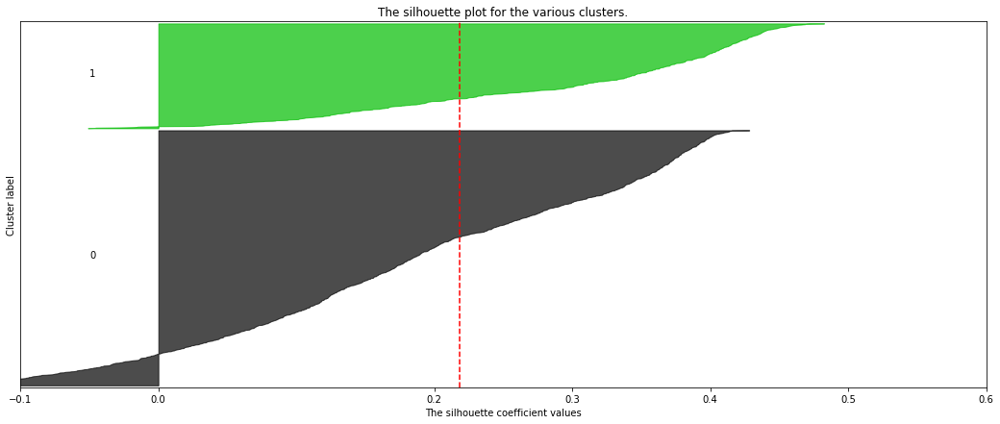

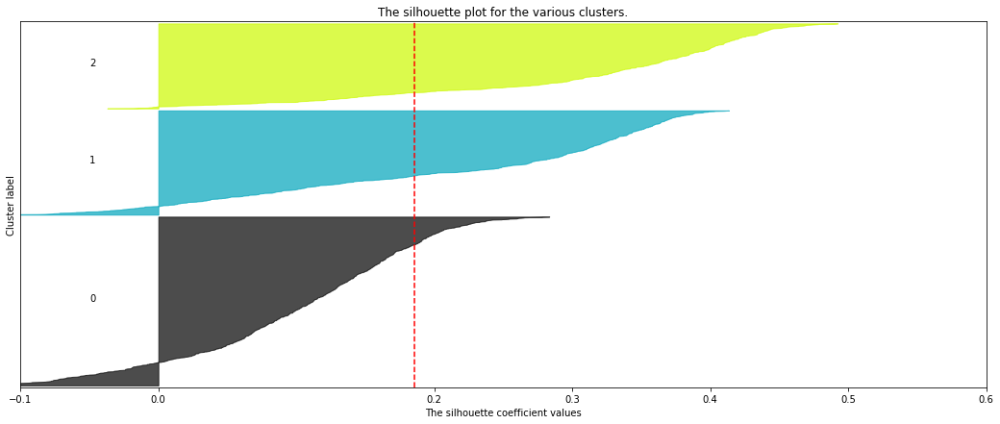

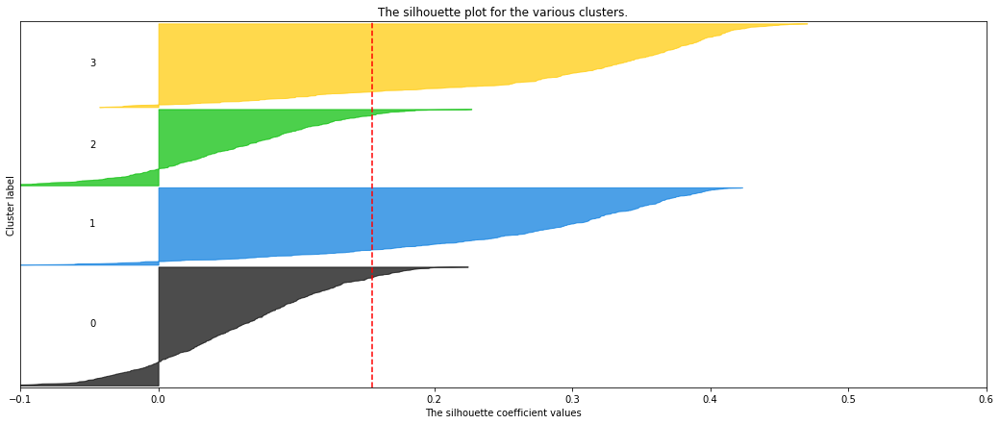

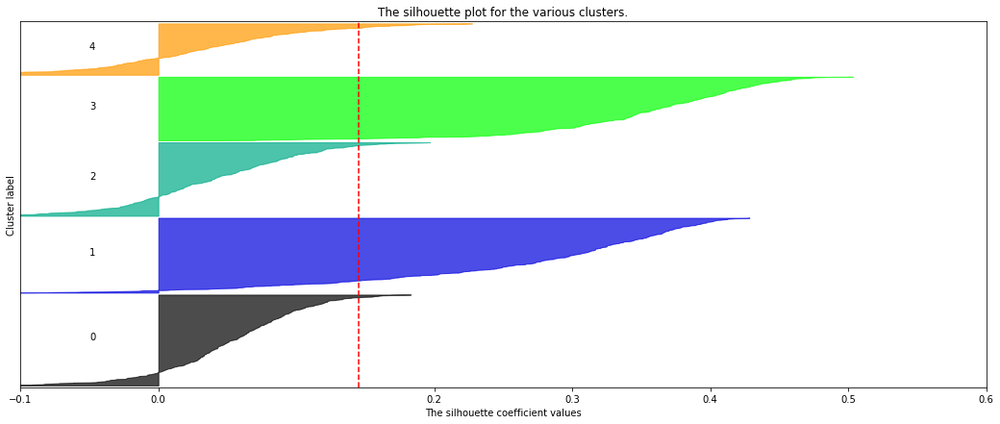

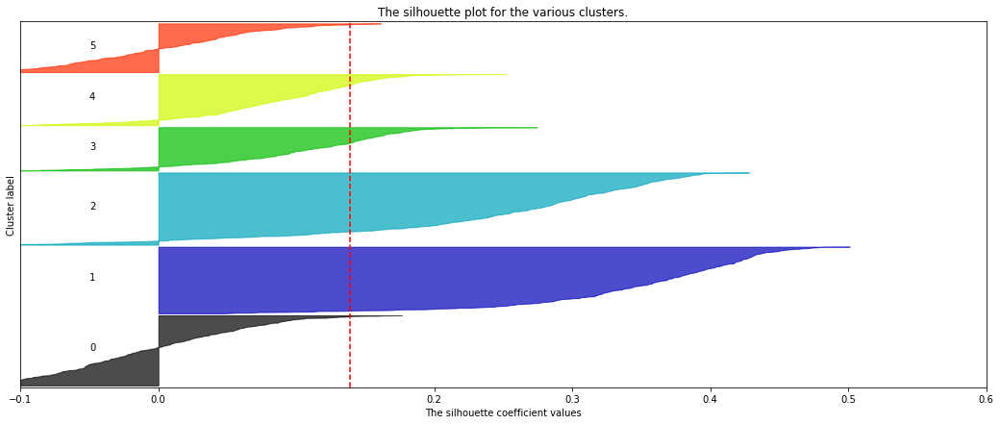

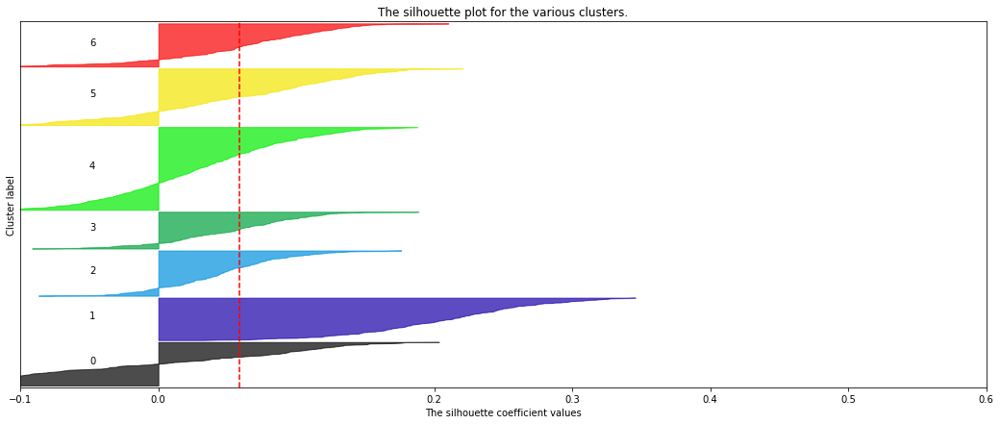

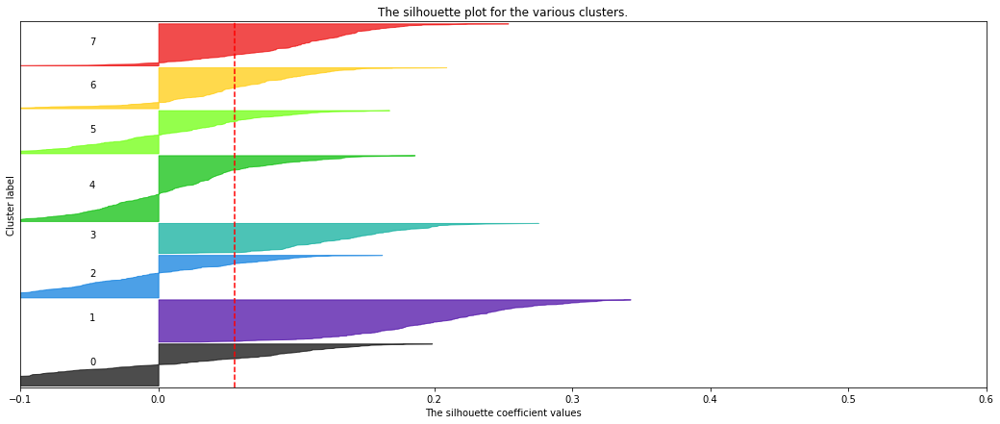

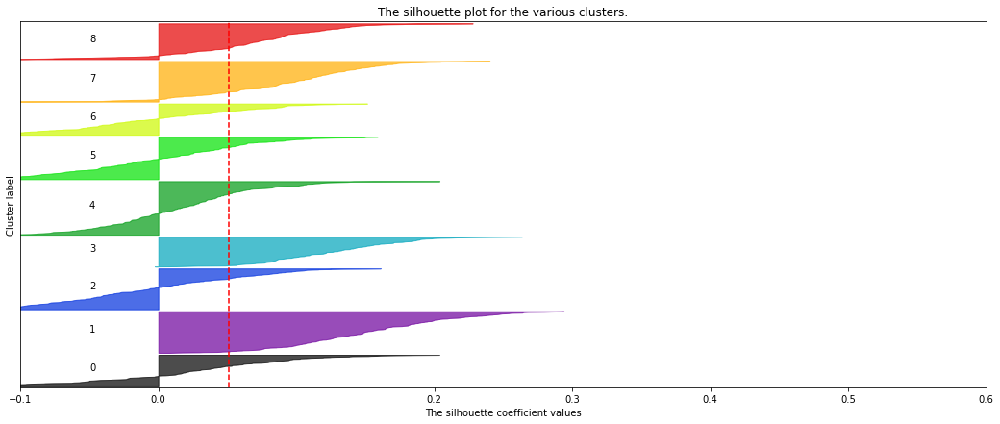

In [ ]:
range_n_clusters = range(2,10)

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1) = plt.subplots(1);
    _ = fig.set_size_inches(18, 7);

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0,1, 0,6]
    _ = ax1.set_xlim([-0.1,0.6]);
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    _ = ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10]);

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    print("For n_clusters =", n_clusters,
          "the average silhouette_score is :", silhouette_scores[n_clusters-2])

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(mix_distance(X), kmedoids_results[n_clusters-2].labels_,metric='precomputed')

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[kmedoids_results[n_clusters-2].labels_ == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        _ = ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        _ = ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    _ = ax1.set_title("The silhouette plot for the various clusters.")
    _ = ax1.set_xlabel("The silhouette coefficient values")
    _ = ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    _ = ax1.axvline(x=silhouette_scores[n_clusters-2], color="red", linestyle="--")

    _ = ax1.set_yticks([])  # Clear the yaxis labels / ticks
    _ = ax1.set_xticks([-0.1, 0, 0.2, 0.3, 0.4,0.5,0.6])

plt.show()

In these graphs emerge the fact that for 2 or 3 clusters the negative tails are less pronounced, and, for this reason, they are the best solutions.

##### Calinski-Harabasz Index

The Calinski-Harabasz index, is the ratio of the sum of between-clusters dispersion and of inter-cluster dispersion for all clusters, the higher the score , the better the performances. More information [here](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.calinski_harabasz_score.html).

In [ ]:
calinski_harabasz_scores = []

for i in range(2, 10):
  Calinski_Harabasz_score = calinski_harabasz_score(X, kmedoids_results[i-2].labels_)
  print(str(i) + " clusters: " + str(Calinski_Harabasz_score))
  calinski_harabasz_scores.append(Calinski_Harabasz_score)

2 clusters: 180.5547571837808
3 clusters: 140.21546307096727
4 clusters: 110.1796151226136
5 clusters: 89.834188992819
6 clusters: 77.81614903392637
7 clusters: 65.2734247744967
8 clusters: 59.976782076417315
9 clusters: 54.5958370118922


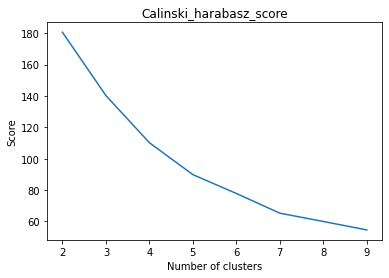

In [ ]:
_ = plt.plot(range(2, 10), calinski_harabasz_scores)
_ = plt.title('Calinski_harabasz_score')
_ = plt.xlabel('Number of clusters')
_ = plt.ylabel('Score')      
plt.show()

The Calinski Harabasz score is higher per 2 clusters. So, from this evaluation method, the best number of clusters could be 2 or eventually 3.

The situation looks identical to [the one of Matlab](https://drive.google.com/file/d/146uXk3qY3ZnePf_2S9UA1XWY0sYdlkL_/view?usp=sharing). 

##### Davies-Bouldin Index

It is a metric for evaluations of cluster.
The score is defined as the average similarity measure of each cluster with its most similar cluster, where similarity is the ratio of within-cluster distances to between-cluster distances. Thus, clusters that are further apart and less dispersed will result in a better score.

More info [here](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.davies_bouldin_score.html).


In [ ]:
davies_bouldin_scores = []

for i in range(2, 10):
  Davies_Bouldin_score = davies_bouldin_score(X, kmedoids_results[i-2].labels_)
  print(str(i) + " clusters: " + str(Davies_Bouldin_score))
  davies_bouldin_scores.append(Davies_Bouldin_score)

2 clusters: 2.978684898953917
3 clusters: 3.4219758517179275
4 clusters: 4.703150758614685
5 clusters: 5.088395974478519
6 clusters: 4.588504179481029
7 clusters: 5.622957900734236
8 clusters: 5.413578359594162
9 clusters: 5.675906017920118


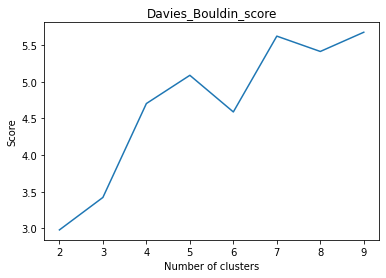

In [ ]:
_ = plt.plot(range(2, 10), davies_bouldin_scores)
_ = plt.title('Davies_Bouldin_score')
_ = plt.xlabel('Number of clusters')
_ = plt.ylabel('Score')      
plt.show()

Since the Davies-Bouldin score to consider is the lowest one, the best choices are again 2 or 3 clusters.

This situation is very different from [what we found in Matlab](https://drive.google.com/file/d/1jh2jIErvn88Je9G7Mksp7gvdB6zs-NgH/view?usp=sharing).

### Spectral Clustering

Spectral clustering is an exploratory data analysis technique that reduces complex multidimensional datasets into clusters of similar data in fewer dimensions. It is a technique that bases itself on graph theory, creating a graph from a selected dataset and identifying communities of nodes in it based on the edges connecting them.
The goal is to cluster the full set of unorganized data points by using information from the eigenvalues (spectrum) of special matrices built from the graph of the data set.

More info [here](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.SpectralClustering.html).

Before making use of the actual algorithm to plot our data's clusters, let us go into details about the structure of our data by deriving its Laplacian matrix and calculating the eigenvalues and corresponding eigenvectors.

As the Spectral Clustering technique is based on  a graph, the process starts by calculating the connectivity matrix of our dataset X. 

To do this, we make use of the kneighbors function, with five as the set numbers of neighbors to use. 
The function input will be the dataframe obtained after computing X with the already defined custom distance function 'mix_distance'. 
Then, we derive from it the adjacency matrix and the corresponding Laplacian matrix.

The next step is to calculate the Laplacian's eigenvalues, respective eigenvectors and then sort them to derive the spectral gap.




In [ ]:
#This function will compute eigenvalues and eigenvectors and project them onto real numbers
def compute_spectrum_graph_laplacian(graph_laplacian):
    eigenvals, eigenvcts = linalg.eig(graph_laplacian)
    eigenvals = np.real(eigenvals)
    eigenvcts = np.real(eigenvcts)
    return eigenvals, eigenvcts




Eigenvalue 0: 1.0887196697215576e-13
Eigenvalue 1: 2.335549385130701
Eigenvalue 2: 4.537979339733106
Eigenvalue 3: 11.969157250958443
Eigenvalue 4: 14.826529758038404
Eigenvalue 5: 16.3410373141048
Eigenvalue 6: 18.328198118478703
Eigenvalue 7: 19.546718249851352
Eigenvalue 8: 21.050718895910123
Eigenvalue 9: 21.701795506441


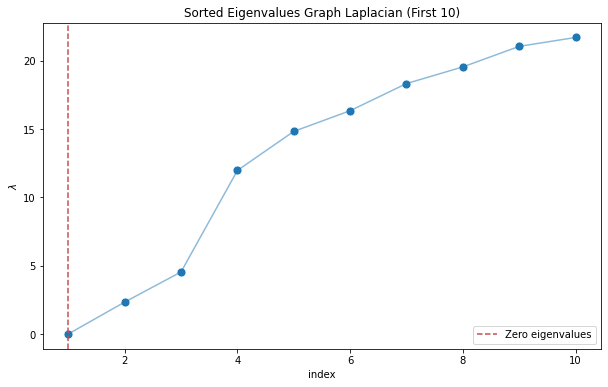

In [ ]:
# Adjacency Matrix.
connectivity = kneighbors_graph(mix_distance(X), 60, mode='connectivity', metric='precomputed')
adjacency_matrix_s = (1/2)*(connectivity + connectivity.T)
# Graph Laplacian.
graph_laplacian_s = sparse.csgraph.laplacian(csgraph=adjacency_matrix_s, normed=False)
graph_laplacian = graph_laplacian_s.toarray()


#Eigenvalues and eigenvectors computation
eigenvals, eigenvcts = compute_spectrum_graph_laplacian(graph_laplacian)


#What we need is information about the smallest eigenvalues, so we need to sort them.
eigenvals_sorted_indices = np.argsort(eigenvals)
eigenvals_sorted = eigenvals[eigenvals_sorted_indices]

#Let us plot these eigenvalues
index_lim = 10

fig, ax = plt.subplots(figsize=(10, 6))
_ = sns.scatterplot(x=range(1, eigenvals_sorted_indices[: index_lim].size + 1), y=eigenvals_sorted[: index_lim], s=80, ax=ax)
_ = sns.lineplot(x=range(1, eigenvals_sorted_indices[: index_lim].size + 1), y=eigenvals_sorted[: index_lim], alpha=0.5, ax=ax)
_ = ax.axvline(x=1, color=sns_c[3], label='Zero eigenvalues', linestyle='--')
_ = ax.legend()
_ = ax.set(title=f'Sorted Eigenvalues Graph Laplacian (First {index_lim})', xlabel='index', ylabel=r'$\lambda$');
print("")
print("")
for i in range (0, 10):
  print("Eigenvalue " + str(i) + ": " + str(eigenvals_sorted[i]))


From our analysis, we found out that a single eigenvalue can be considered zero, meaning that the size of our spectral gap is one, so our graph is one connected componenent. 

It is interesting to note that the next ten eigenvalues following the first one rapidly increase in value, the biggest gap being between the third and fourth eigenvalues. This tells us that our graph is a few edges away to being formed by three connected components.

It is just a first approximation that will need to be compared with other evaluation metrics and with the dataset visual representation, but it gives us an idea on the possible amount of clusters.

In [ ]:
spectral_results = []

for i in range(2, 10):
    spectral_labels = SpectralClustering(n_clusters=i, random_state=SEED, affinity='precomputed_nearest_neighbors').fit_predict(mix_distance(X))
    spectral_results.append(spectral_labels)

Now that we had a first general idea of our eigenvalues, we will proceed to plot the identified possible clusters by making use of the labels produced by the actual Spectral algorithm

The metric used in this computation is based on the Nearest Neighbor algorithm, which will interpret the input matrix as a sparse graph of precomputed distances, and construct a binary affinity matrix using ten neighbors.


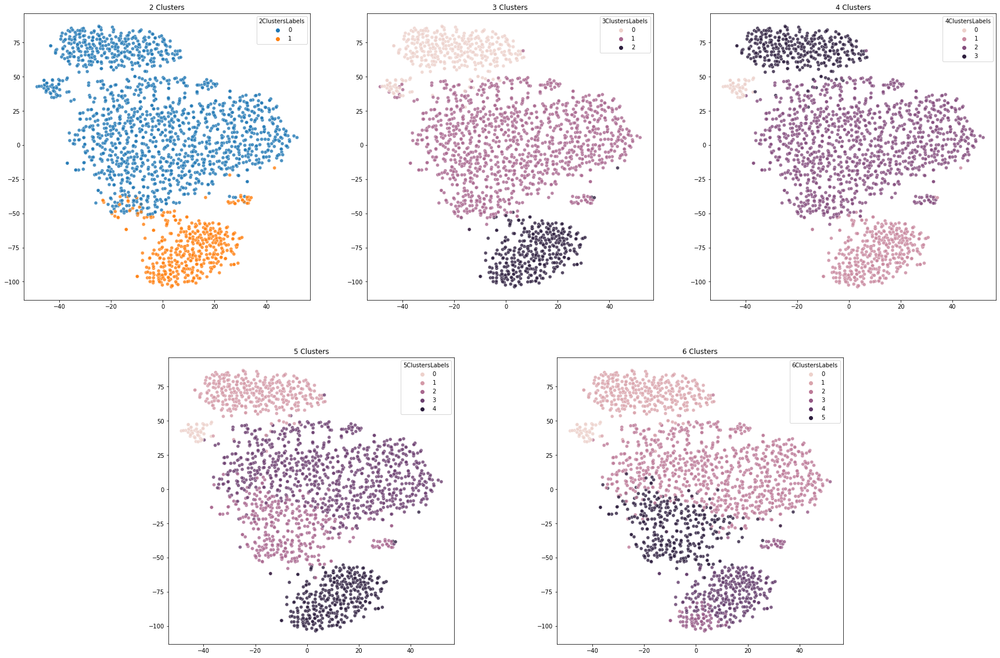

In [ ]:
Y = X_readable.copy()
Y['2ClustersLabels'] = spectral_results[0]
Y['3ClustersLabels'] = spectral_results[1]
Y['4ClustersLabels'] = spectral_results[2]
Y['5ClustersLabels'] = spectral_results[3]
Y['6ClustersLabels'] = spectral_results[4]


fig, axs = plt.subplots(2,3, figsize=(30,20))
_ = axs[1][2].set_visible(False)

_ = axs[1][0].set_position([0.24,0.125,0.228,0.343])
_ = axs[1][1].set_position([0.55,0.125,0.228,0.343])

_ = axs[0][0].set_title('2 Clusters')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=Y,
    hue='2ClustersLabels',
    ax=axs[0][0]
)
_ = axs[0][1].set_title('3 Clusters')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=Y,
    hue='3ClustersLabels',
    ax=axs[0][1]
)
_ = axs[0][2].set_title('4 Clusters')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=Y,
    hue='4ClustersLabels',
    ax=axs[0][2]
)
_ = axs[1][0].set_title('5 Clusters')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=Y,
    hue='5ClustersLabels',
    ax=axs[1][0]
)
_ = axs[1][1].set_title('6 Clusters')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0], y=tsne_results_mix[:,1],
    alpha=0.8,
    data=Y,
    hue='6ClustersLabels',
    ax=axs[1][1]
)

#### Evaluation

We will use only these 3 idexes:

* Silhouette Index
* Calinski-Hartabasz Index
* Davies-Bouldin Index

##### Silhouette Index

In [ ]:
silhouette_scores = []

for i in range(2, 10):
    silhouette_avg = silhouette_score(mix_distance(X), spectral_results[i-2], metric='precomputed')
    print(str(i) + " clusters: " + str(silhouette_avg))
    silhouette_scores.append(silhouette_avg)

2 clusters: 0.23301339338980684
3 clusters: 0.1895795252874018
4 clusters: 0.16937302133818113
5 clusters: 0.15620525695514306
6 clusters: 0.12209129725958379
7 clusters: 0.12154094658598746
8 clusters: 0.12320909632892317
9 clusters: 0.12390785425894417


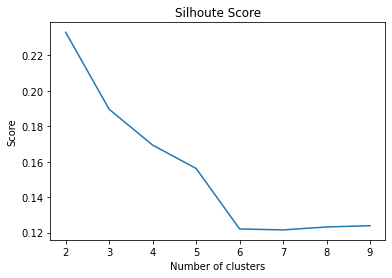

In [ ]:
_ = plt.plot(range(2, 10), silhouette_scores)
_ = plt.title('Silhoute Score')
_ = plt.xlabel('Number of clusters')
_ = plt.ylabel('Score')      
plt.show()

The Silhouette score is higher per 2 clusters. So, from this evaluation method, the best number of clusters could be 2 or eventually 3.

For n_clusters = 2 The average silhouette_score is : 0.23301339338980684
For n_clusters = 3 The average silhouette_score is : 0.1895795252874018
For n_clusters = 4 The average silhouette_score is : 0.16937302133818113
For n_clusters = 5 The average silhouette_score is : 0.15620525695514306
For n_clusters = 6 The average silhouette_score is : 0.12209129725958379
For n_clusters = 7 The average silhouette_score is : 0.12154094658598746
For n_clusters = 8 The average silhouette_score is : 0.12320909632892317
For n_clusters = 9 The average silhouette_score is : 0.12390785425894417


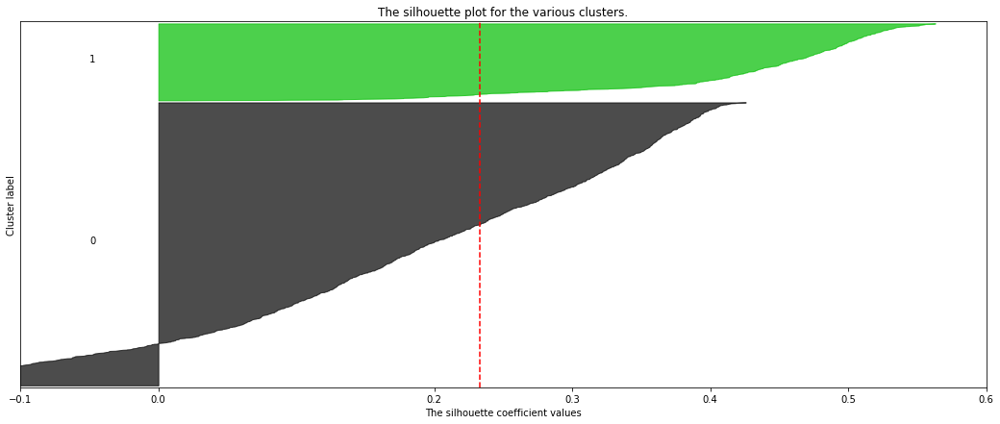

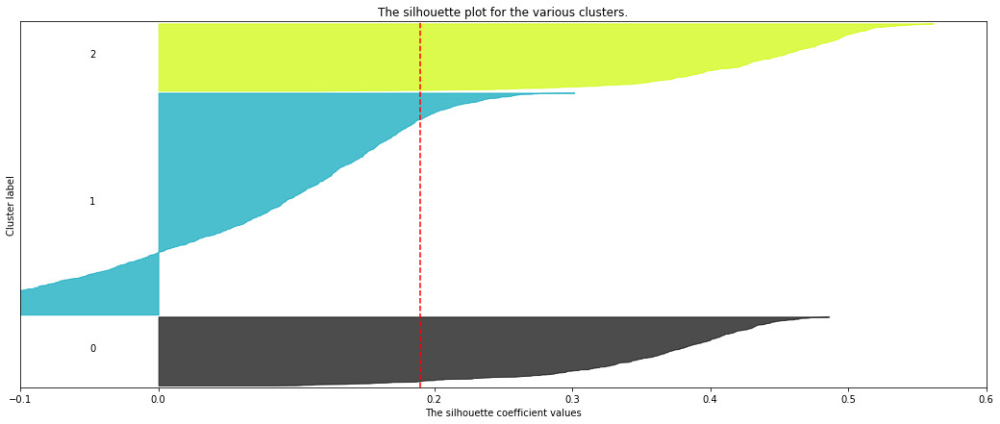

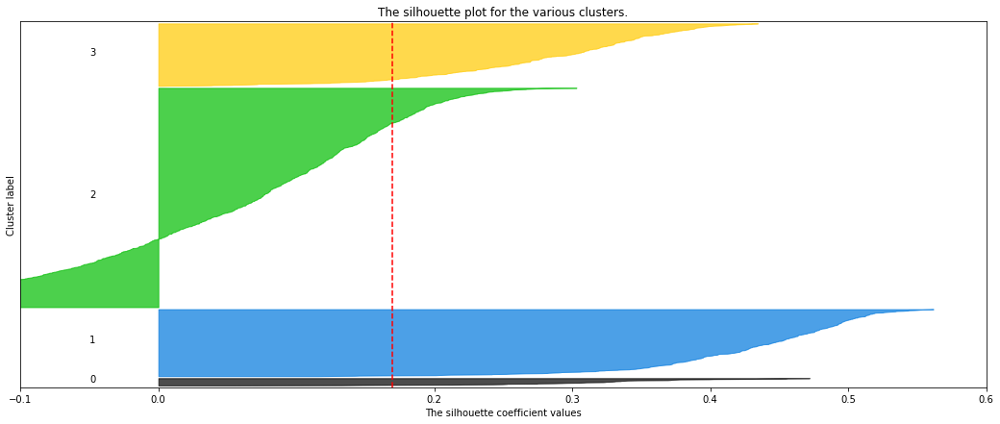

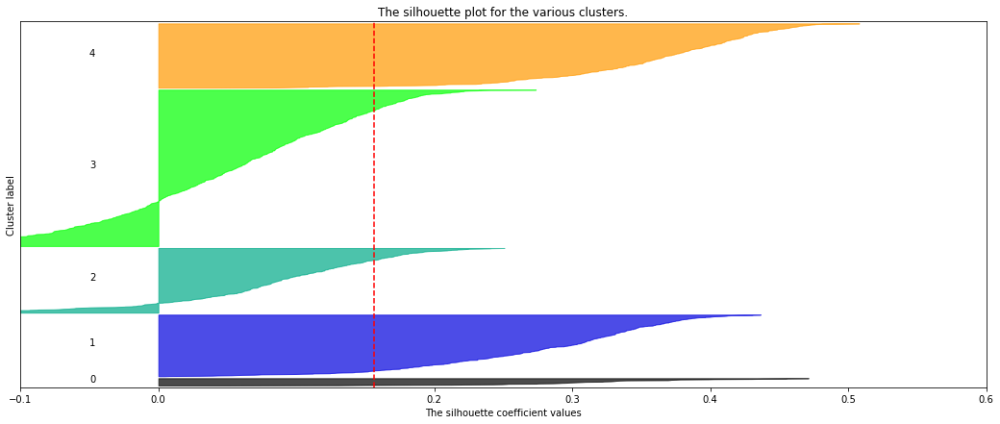

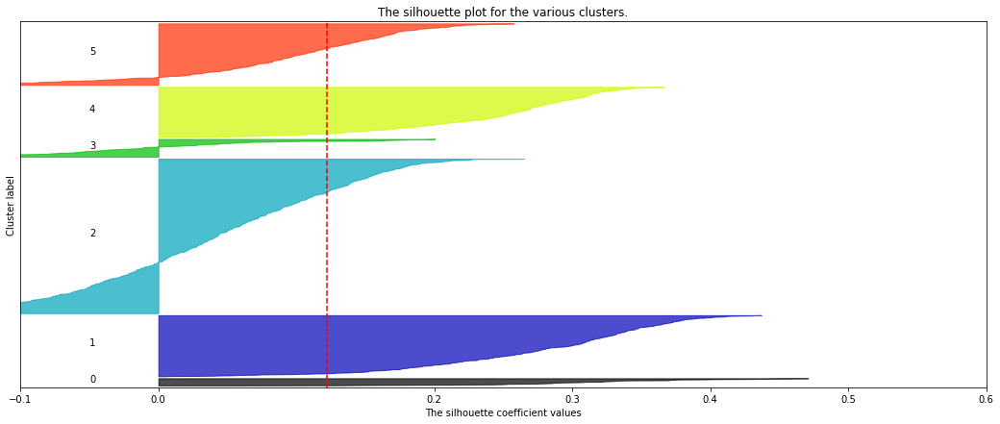

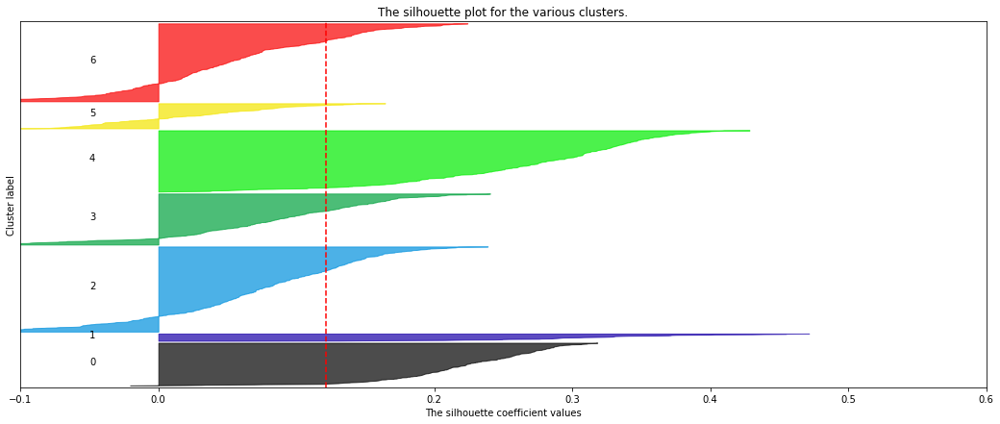

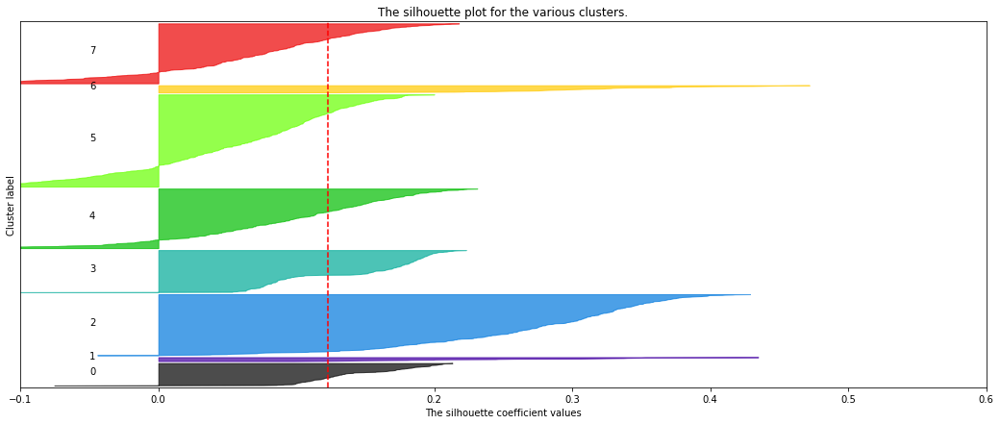

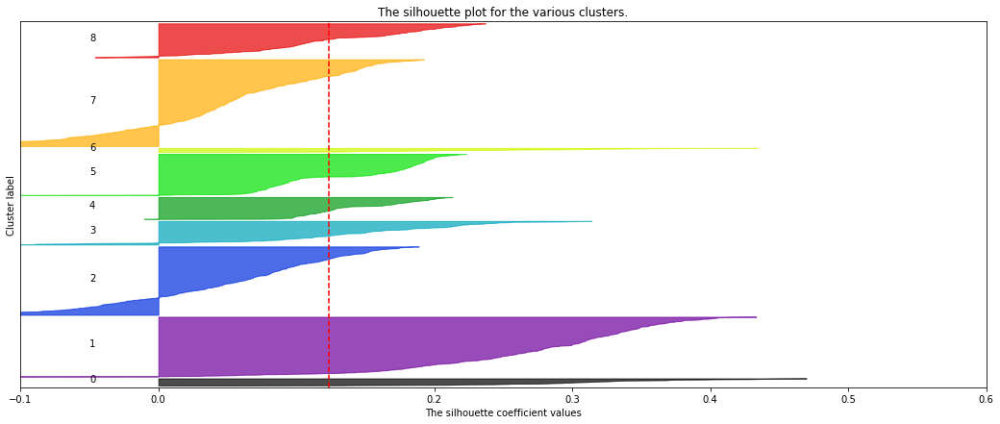

In [ ]:
range_n_clusters = range(2,10)

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1) = plt.subplots(1)
    _ = fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0,1, 0,6]
    _ = ax1.set_xlim([-0.1,0.6])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    _ = ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_scores[n_clusters-2])

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(mix_distance(X), spectral_results[n_clusters-2],metric='precomputed')

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[spectral_results[n_clusters-2] == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        _ = ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        _ = ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    _ = ax1.set_title("The silhouette plot for the various clusters.")
    _ = ax1.set_xlabel("The silhouette coefficient values")
    _ = ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    _ = ax1.axvline(x=silhouette_scores[n_clusters-2], color="red", linestyle="--")

    _ = ax1.set_yticks([])  # Clear the yaxis labels / ticks
    _ = ax1.set_xticks([-0.1, 0, 0.2, 0.3, 0.4,0.5,0.6])

plt.show()

Exactly as stated by the numerical results, by evaluating the tails of these plots, the configuration with 2 or 3 clusters are the ones that give the best results.

##### Calinski-Harabasz Index

In [ ]:
calinski_harabasz_scores = []

for i in range(2, 10):
  Calinski_Harabasz_score = calinski_harabasz_score(X, spectral_results[i-2])
  print(str(i) + " clusters: " + str(Calinski_Harabasz_score))
  calinski_harabasz_scores.append(Calinski_Harabasz_score)

2 clusters: 138.42304006064208
3 clusters: 157.644173996421
4 clusters: 113.16699057427857
5 clusters: 98.87707629369129
6 clusters: 80.83323048541305
7 clusters: 73.85366194970928
8 clusters: 66.78572113370181
9 clusters: 62.78071265376357


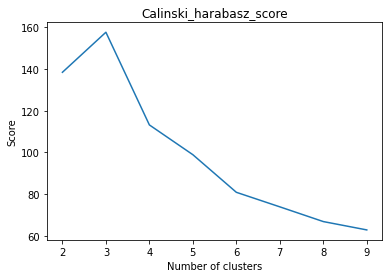

In [ ]:
_ = plt.plot(range(2, 10), calinski_harabasz_scores)
_ = plt.title('Calinski_harabasz_score')
_ = plt.xlabel('Number of clusters')
_ = plt.ylabel('Score')      
plt.show()

Unlike the silhouette score, the Calinski-Harabasz score is higher with 3 clusters, with 2 being the second possible choice.

##### Davies-Bouldin Index

In [ ]:
davies_bouldin_scores = []

for i in range(2, 10):
  Davies_Bouldin_score = davies_bouldin_score(X, spectral_results[i-2])
  print(str(i) + " clusters: " + str(Davies_Bouldin_score))
  davies_bouldin_scores.append(Davies_Bouldin_score)

2 clusters: 2.885953918485637
3 clusters: 2.8933961841435676
4 clusters: 2.912236842384
5 clusters: 3.637143908703613
6 clusters: 4.047817900636679
7 clusters: 4.466247163629641
8 clusters: 4.185601437478729
9 clusters: 4.109187644886504


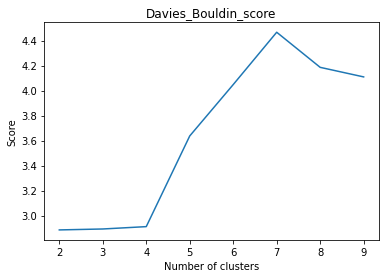

In [ ]:
_ = plt.plot(range(2, 10), davies_bouldin_scores)
_ = plt.title('Davies_Bouldin_score')
_ = plt.xlabel('Number of clusters')
_ = plt.ylabel('Score')      
plt.show()

From the Davies Bouldin score, the number of clusters that produce the best results is 2, with 3 and 4 being very close alternatives.

It is interesting to note that the three evaluation methods produce similar results, but the difference in values of the 2/3/4 clusters alternative are very varied, with the Davies Bouldin returning the closest scores and the Calinsky-Harabz the furthest apart.

### DBscan

DBSCAN finds patterns in data without being explicitly told what pattern to find by measuring the distance each point is from one another, and if enough points are close enough together, then DBSCAN will classify it as a new cluster. We have different parameters the most important are: Epsilon — The maximum distance a point can be from another point to be considered a neighbor. Min_Points — The number of points needed within the range of epsilon to be considered a cluster.

More information [here](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.DBSCAN.html).

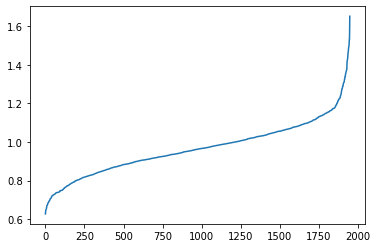

In [ ]:
minpts = 60

distances = mix_distance(X)
sorted_distances = np.sort(distances, axis=0)
sorted_distances = sorted_distances[minpts,:]
_ = plt.plot(np.sort(sorted_distances))

The values ​​where the graph shows a knee are in correspondence of 0.75 and 1.15 so these are the best epsilon values.
We discarded the last value because it only had one cluster as an output.

In [ ]:
eps = 0.70
dbscan_labels_1 = DBSCAN(eps=eps, min_samples=minpts, metric='precomputed').fit_predict(distances)

eps = 0.75
dbscan_labels_2 = DBSCAN(eps=eps, min_samples=minpts, metric='precomputed').fit_predict(distances)

eps = 0.80
dbscan_labels_3 = DBSCAN(eps=eps, min_samples=minpts, metric='precomputed').fit_predict(distances)

eps = 0.85 
dbscan_labels_4 = DBSCAN(eps=eps, min_samples=minpts, metric='precomputed').fit_predict(distances)

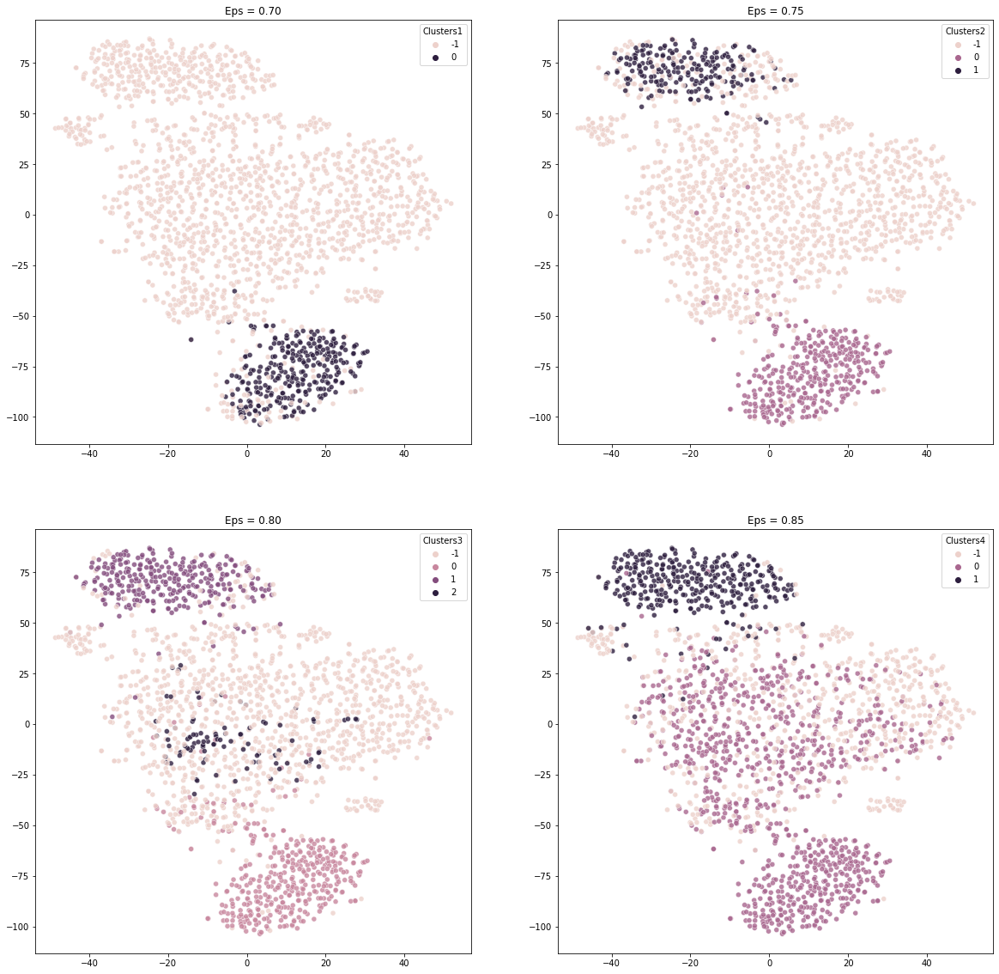

In [ ]:
Y = X_readable.copy()
Y['Clusters1'] = dbscan_labels_1
Y['Clusters2'] = dbscan_labels_2
Y['Clusters3'] = dbscan_labels_3
Y['Clusters4'] = dbscan_labels_4

fig, axs = plt.subplots(2, 2, figsize=(20,20))

_ = axs[0][0].set_title('Eps = 0.70')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0],y=tsne_results_mix[:,1],
    alpha=0.8,
    data=Y,
    hue='Clusters1',
    ax=axs[0][0]
)

_ = axs[0][1].set_title('Eps = 0.75')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0],y=tsne_results_mix[:,1],
    alpha=0.8,
    data=Y,
    hue='Clusters2',
    ax=axs[0][1]
)
_ = axs[1][0].set_title('Eps = 0.80')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0],y=tsne_results_mix[:,1],
    alpha=0.8,
    data=Y,
    hue='Clusters3',
    ax=axs[1][0]
)

_ = axs[1][1].set_title('Eps = 0.85')
_ = sns.scatterplot(
    x=tsne_results_mix[:,0],y=tsne_results_mix[:,1],
    alpha=0.8,
    data=Y,
    hue='Clusters4',
    ax=axs[1][1]
)

In the first graph, we see that the output is represented by too many outliers and only one cluster, this means that the epsilon value is too small. In the graph on the upper-right, we can see that there are 2 clusters and still too many outliers.
By increasing the epsilon value a little more, the outliers decrease and in the graph at the bottom right 2 clusters are outlined while the one on the left outlines 3.
The best results obtained from this study, however, do not give us well-defined clusters, for this reason, we think that this algorithm does not fit very weel this dataset and so does not bring the expexted results for our purposes.

## GOWER DISTANCE CLUSTERING

### K-Medoids Clustering

In [ ]:
kmedoids_results = []

for i in range(2, 10):
    kmedoids = KMedoids(n_clusters=i, metric='precomputed', method='pam', max_iter=20, random_state=SEED).fit(gower.gower_matrix(X))
    kmedoids_results.append(kmedoids)
    print("KMedoids with " + str(i) + " cluster inertia: " + str(kmedoids.inertia_))

KMedoids with 2 cluster inertia: 390.6724
KMedoids with 3 cluster inertia: 356.51846
KMedoids with 4 cluster inertia: 335.72287
KMedoids with 5 cluster inertia: 319.24155
KMedoids with 6 cluster inertia: 309.7289
KMedoids with 7 cluster inertia: 298.90607
KMedoids with 8 cluster inertia: 291.94714
KMedoids with 9 cluster inertia: 284.97696


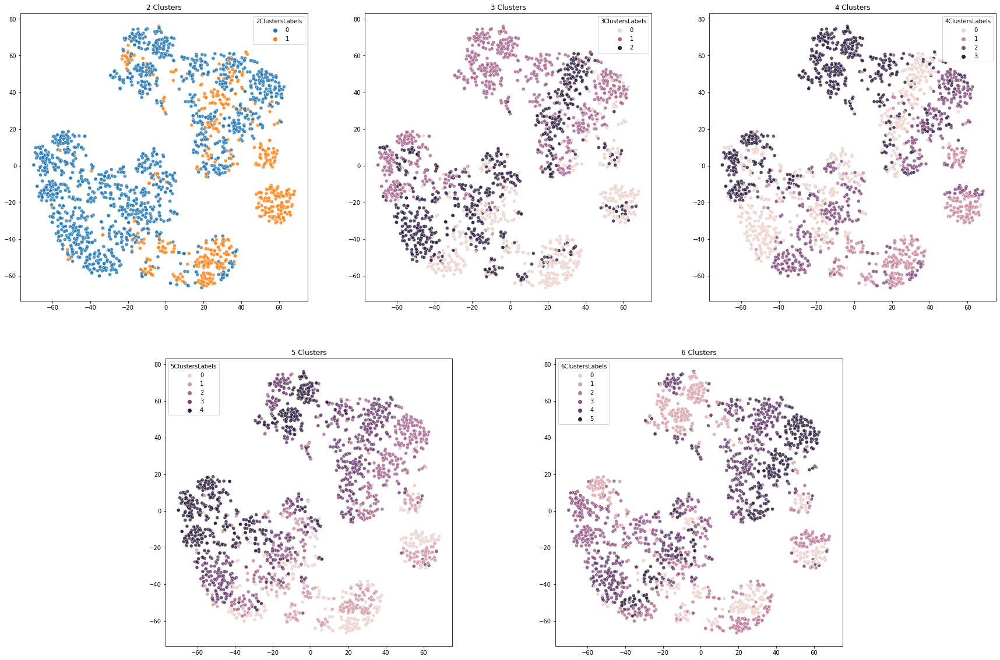

In [ ]:
Y = X_readable.copy()
Y['2ClustersLabels'] = kmedoids_results[0].labels_
Y['3ClustersLabels'] = kmedoids_results[1].labels_
Y['4ClustersLabels'] = kmedoids_results[2].labels_
Y['5ClustersLabels'] = kmedoids_results[3].labels_
Y['6ClustersLabels'] = kmedoids_results[4].labels_


fig, axs = plt.subplots(2,3, figsize=(30,20))
_ = axs[1][2].set_visible(False)

_ = axs[1][0].set_position([0.24,0.125,0.228,0.343])
_ = axs[1][1].set_position([0.55,0.125,0.228,0.343])

_ = axs[0][0].set_title('2 Clusters')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=Y,
    hue='2ClustersLabels',
    ax=axs[0][0]
)
_ = axs[0][1].set_title('3 Clusters')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=Y,
    hue='3ClustersLabels',
    ax=axs[0][1]
)
_ = axs[0][2].set_title('4 Clusters')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=Y,
    hue='4ClustersLabels',
    ax=axs[0][2]
)
_ = axs[1][0].set_title('5 Clusters')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=Y,
    hue='5ClustersLabels',
    ax=axs[1][0]
)
_ = axs[1][1].set_title('6 Clusters')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=Y,
    hue='6ClustersLabels',
    ax=axs[1][1]
)

#### Evaluation

##### Elbow Rule

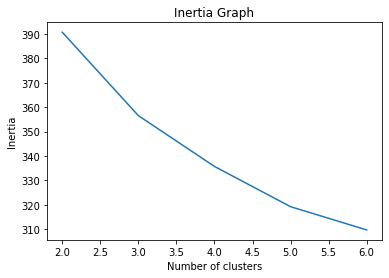

In [ ]:
_ = plt.plot(range(2, 7), [kmedoids.inertia_ for kmedoids in kmedoids_results[:5]])
_ = plt.title('Inertia Graph')
_ = plt.xlabel('Number of clusters')
_ = plt.ylabel('Inertia')    
plt.show()

From the graph, it is not very clear what the recommended value of this algorithm is, however, a slight curvature can be seen in correspondence with the 3 clusters. So the indicated value could be 3.

##### Silhouette Index

In [ ]:
silhouette_scores = []

for i in range(2, 10):
    silhouette_avg = silhouette_score(gower.gower_matrix(X), kmedoids_results[i-2].labels_, metric='precomputed')
    print(str(i) + " clusters: " + str(silhouette_avg))
    silhouette_scores.append(silhouette_avg)

2 clusters: 0.17333144
3 clusters: 0.12967005
4 clusters: 0.15074416
5 clusters: 0.15704761
6 clusters: 0.13882361
7 clusters: 0.13942729
8 clusters: 0.13861431
9 clusters: 0.14089195


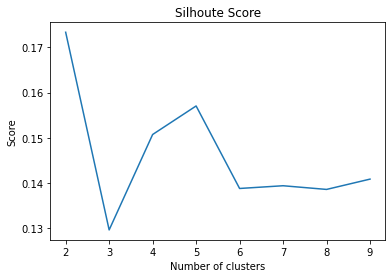

In [ ]:
_ = plt.plot(range(2, 10), silhouette_scores)
_ = plt.title('Silhoute Score')
_ = plt.xlabel('Number of clusters')
_ = plt.ylabel('Score')      
plt.show()

The Silhouette score is higher per 2 clusters. So, from this evaluation method, the best number of clusters could be 2 or eventually 5.

For n_clusters = 2 The average silhouette_score is : 0.17333144
For n_clusters = 3 The average silhouette_score is : 0.12967005
For n_clusters = 4 The average silhouette_score is : 0.15074416
For n_clusters = 5 The average silhouette_score is : 0.15704761
For n_clusters = 6 The average silhouette_score is : 0.13882361
For n_clusters = 7 The average silhouette_score is : 0.13942729
For n_clusters = 8 The average silhouette_score is : 0.13861431
For n_clusters = 9 The average silhouette_score is : 0.14089195


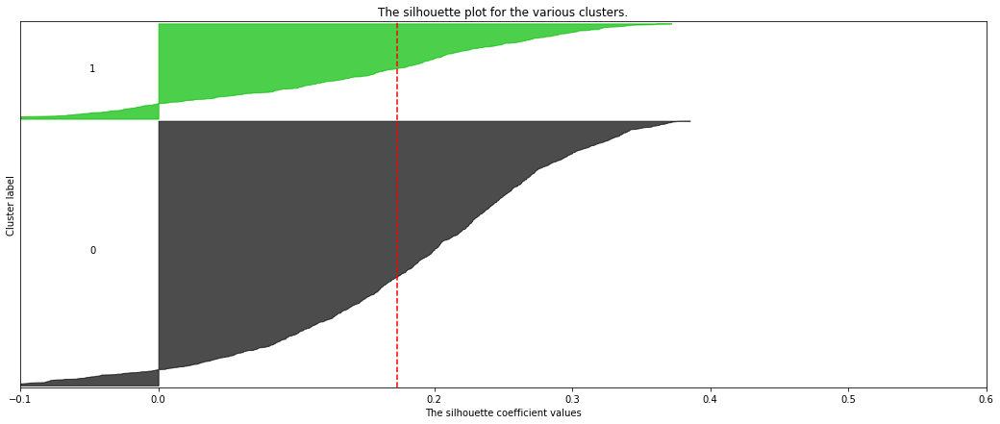

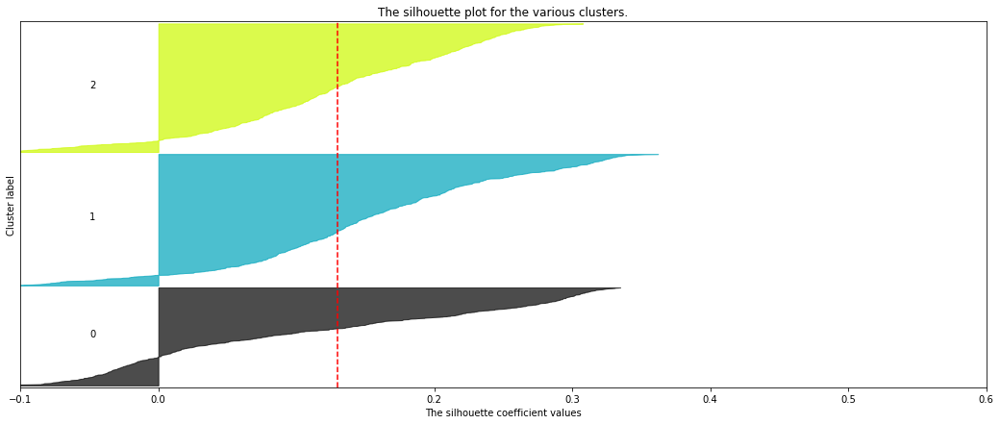

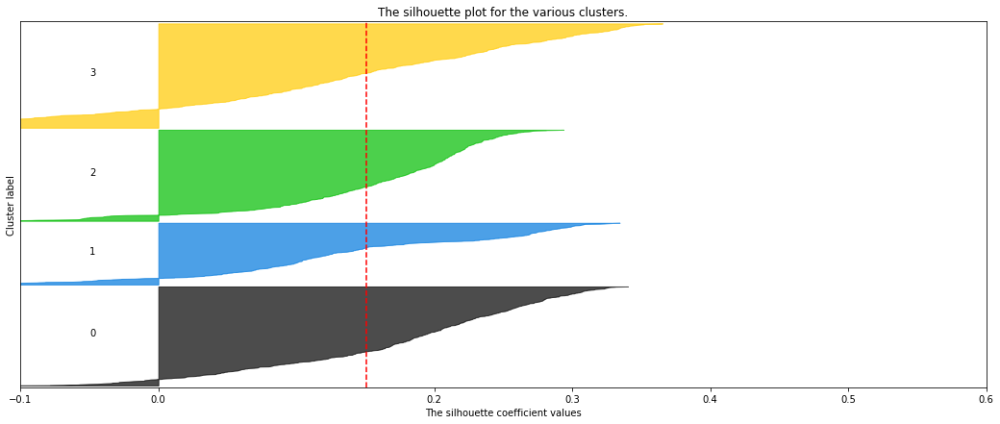

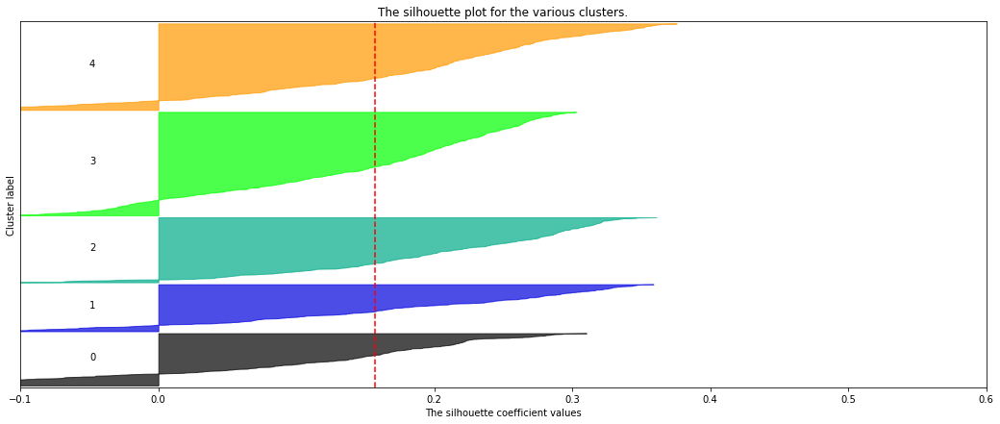

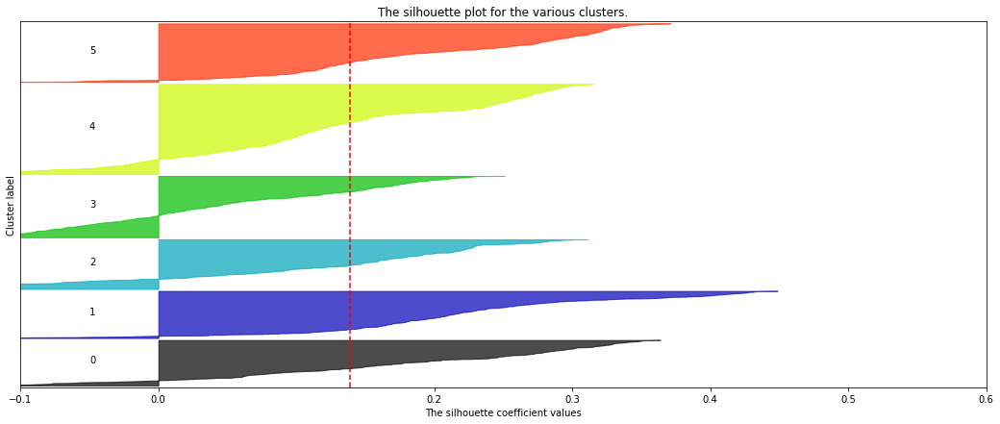

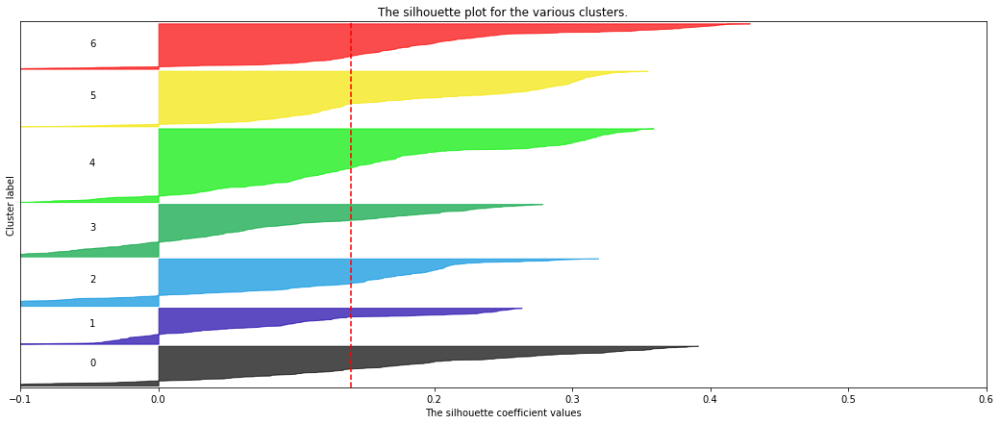

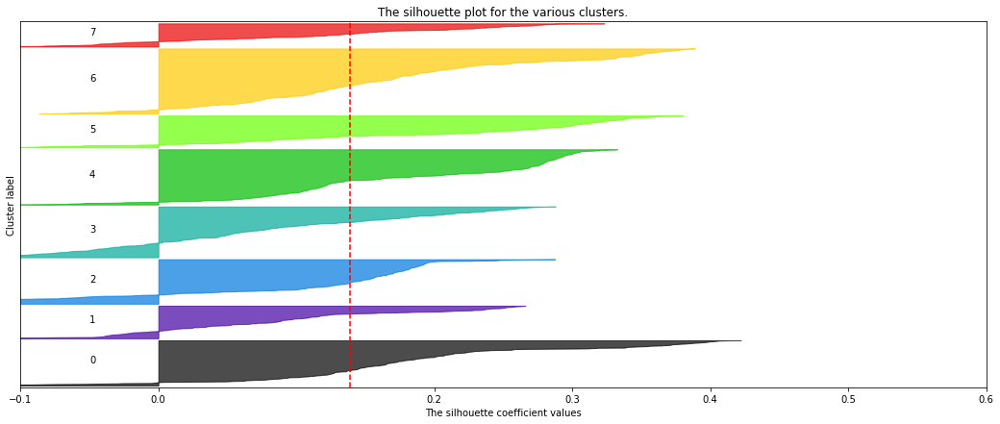

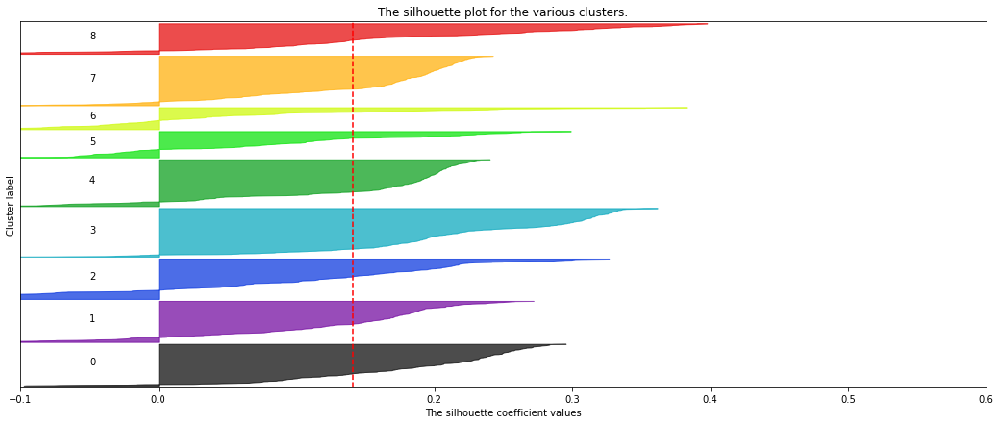

In [ ]:
range_n_clusters = range(2,10)

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1) = plt.subplots(1)
    _ = fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0,1, 0,6]
    _ = ax1.set_xlim([-0.1,0.6])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    _ = ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_scores[n_clusters-2])

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(gower.gower_matrix(X), kmedoids_results[n_clusters-2].labels_,metric='precomputed')

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[kmedoids_results[n_clusters-2].labels_ == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        _ = ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        _ = ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    _ = ax1.set_title("The silhouette plot for the various clusters.")
    _ = ax1.set_xlabel("The silhouette coefficient values")
    _ = ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    _ = ax1.axvline(x=silhouette_scores[n_clusters-2], color="red", linestyle="--")

    _ = ax1.set_yticks([])  # Clear the yaxis labels / ticks
    _ = ax1.set_xticks([-0.1, 0, 0.2, 0.3, 0.4,0.5,0.6])

plt.show()

In these graphs emerge the fact that for 2 or 5 clusters the negative tails are less pronounced, and, for this reason, they are the best solutions.

##### Calinski-Harabasz Index

In [ ]:
calinski_harabasz_scores = []

for i in range(2, 10):
  Calinski_Harabasz_score = calinski_harabasz_score(X, kmedoids_results[i-2].labels_)
  print(str(i) + " clusters: " + str(Calinski_Harabasz_score))
  calinski_harabasz_scores.append(Calinski_Harabasz_score)

2 clusters: 189.175062751985
3 clusters: 186.23654176650786
4 clusters: 203.41283072096067
5 clusters: 186.86792466625732
6 clusters: 168.68405655103808
7 clusters: 167.10858177490152
8 clusters: 156.13592432847244
9 clusters: 150.34340216179282


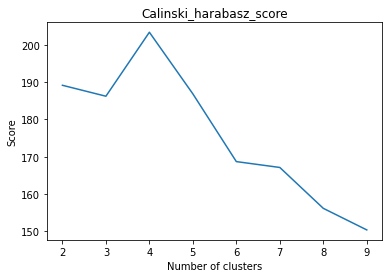

In [ ]:
_ = plt.plot(range(2, 10), calinski_harabasz_scores)
_ = plt.title('Calinski_harabasz_score')
_ = plt.xlabel('Number of clusters')
_ = plt.ylabel('Score')      
plt.show()

The Calinski Harabasz score is higher per 4 clusters. So, from this evaluation method, the best number of clusters could be 4 or eventually 2.

##### Davies-Bouldin Index

In [ ]:
davies_bouldin_scores = []

for i in range(2, 10):
  Davies_Bouldin_score = davies_bouldin_score(X, kmedoids_results[i-2].labels_)
  print(str(i) + " clusters: " + str(Davies_Bouldin_score))
  davies_bouldin_scores.append(Davies_Bouldin_score)

2 clusters: 2.823586909807809
3 clusters: 2.7027835478722655
4 clusters: 2.447507784732064
5 clusters: 2.4859456399499638
6 clusters: 2.4029408392959755
7 clusters: 2.202151990546202
8 clusters: 2.14763619872247
9 clusters: 2.177111903937819


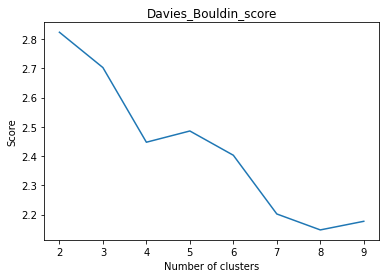

In [ ]:
_ = plt.plot(range(2, 10), davies_bouldin_scores)
_ = plt.title('Davies_Bouldin_score')
_ = plt.xlabel('Number of clusters')
_ = plt.ylabel('Score')      
plt.show()

Since the Davies-Bouldin score to consider is the lowest one, the best choices are, according to this graph, 8 or 9 clusters.

### Spectral Clustering

In [ ]:
spectral_results = []

for i in range(2, 10):
    spectral_labels = SpectralClustering(n_clusters=i, random_state=SEED, affinity='precomputed_nearest_neighbors').fit_predict(gower.gower_matrix(X))
    spectral_results.append(spectral_labels)

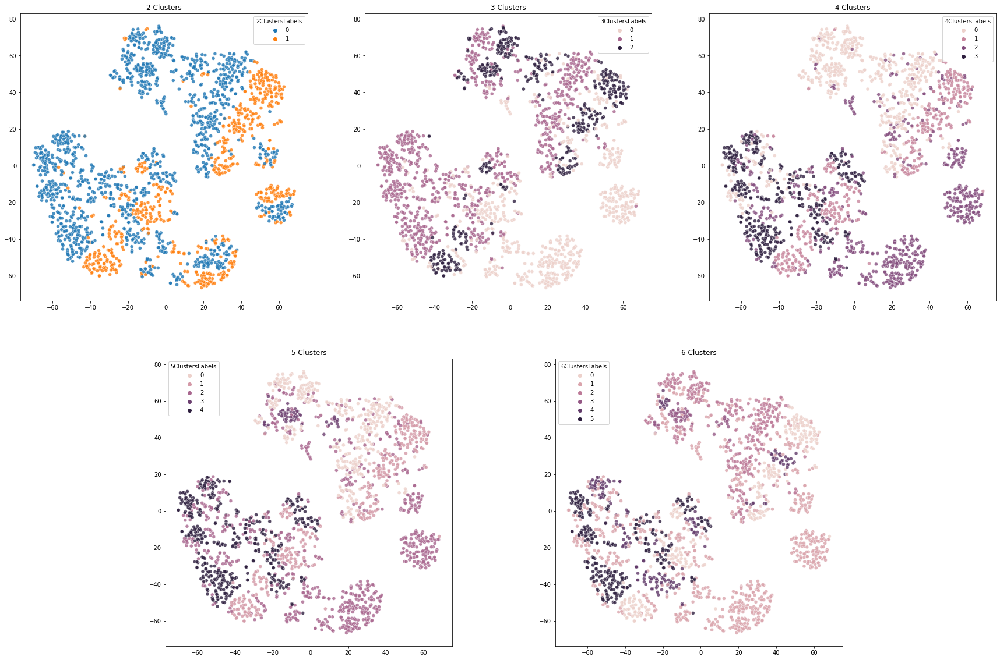

In [ ]:
Y = X_readable.copy()
Y['2ClustersLabels'] = spectral_results[0]
Y['3ClustersLabels'] = spectral_results[1]
Y['4ClustersLabels'] = spectral_results[2]
Y['5ClustersLabels'] = spectral_results[3]
Y['6ClustersLabels'] = spectral_results[4]


fig, axs = plt.subplots(2,3, figsize=(30,20))
_ = axs[1][2].set_visible(False)

_ = axs[1][0].set_position([0.24,0.125,0.228,0.343])
_ = axs[1][1].set_position([0.55,0.125,0.228,0.343])

_ = axs[0][0].set_title('2 Clusters')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=Y,
    hue='2ClustersLabels',
    ax=axs[0][0]
)
_ = axs[0][1].set_title('3 Clusters')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=Y,
    hue='3ClustersLabels',
    ax=axs[0][1]
)
_ = axs[0][2].set_title('4 Clusters')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=Y,
    hue='4ClustersLabels',
    ax=axs[0][2]
)
_ = axs[1][0].set_title('5 Clusters')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=Y,
    hue='5ClustersLabels',
    ax=axs[1][0]
)
_ = axs[1][1].set_title('6 Clusters')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0], y=tsne_results_gower[:,1],
    alpha=0.8,
    data=Y,
    hue='6ClustersLabels',
    ax=axs[1][1]
)

#### Evaluation

##### Silhouette Index

In [ ]:
silhouette_scores = []

for i in range(2, 10):
    silhouette_avg = silhouette_score(gower.gower_matrix(X), spectral_results[i-2], metric='precomputed')
    print(str(i) + " clusters: " + str(silhouette_avg))
    silhouette_scores.append(silhouette_avg)

2 clusters: 0.1849861
3 clusters: 0.096367665
4 clusters: 0.10025259
5 clusters: 0.0303198
6 clusters: 0.019209785
7 clusters: 0.034294866
8 clusters: 0.039723597
9 clusters: 0.028709095


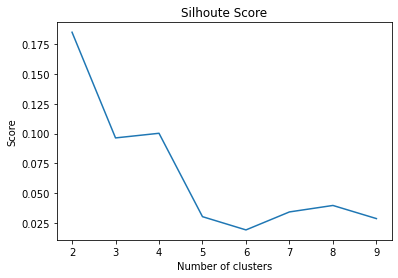

In [ ]:
_ = plt.plot(range(2, 10), silhouette_scores)
_ = plt.title('Silhoute Score')
_ = plt.xlabel('Number of clusters')
_ = plt.ylabel('Score')      
plt.show()

Just as the plot computation made using the Mix Distance results, the Silhoutte Index score suggests that 2 clusters are the configuration with the best results.

One difference is that the second possible choice is now the configuration with 4 clusters, instead of 3, with 6 clusters returning the worst scores. Also, the scores are now far more different in value when compared to the run done with Mix Distance, as the score of the 2 and 3 clusters configuration differ from nearly 97%.

For n_clusters = 2 The average silhouette_score is : 0.1849861
For n_clusters = 3 The average silhouette_score is : 0.096367665
For n_clusters = 4 The average silhouette_score is : 0.10025259
For n_clusters = 5 The average silhouette_score is : 0.0303198
For n_clusters = 6 The average silhouette_score is : 0.019209785
For n_clusters = 7 The average silhouette_score is : 0.034294866
For n_clusters = 8 The average silhouette_score is : 0.039723597
For n_clusters = 9 The average silhouette_score is : 0.028709095


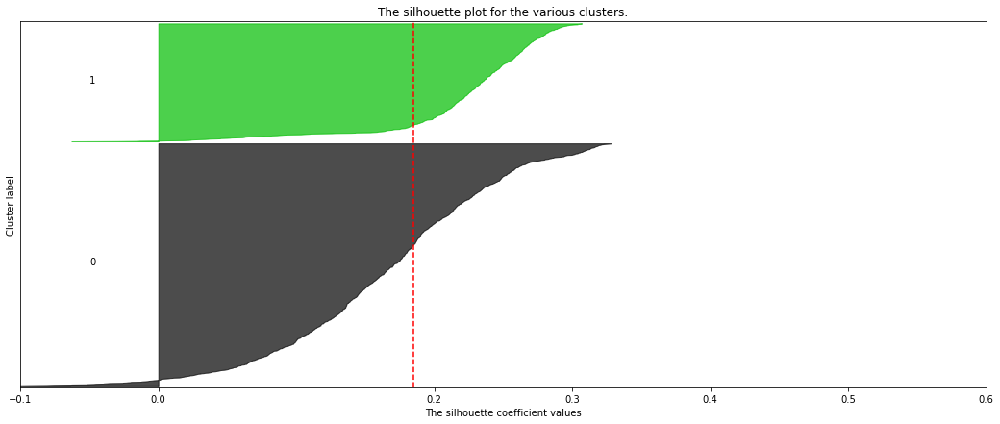

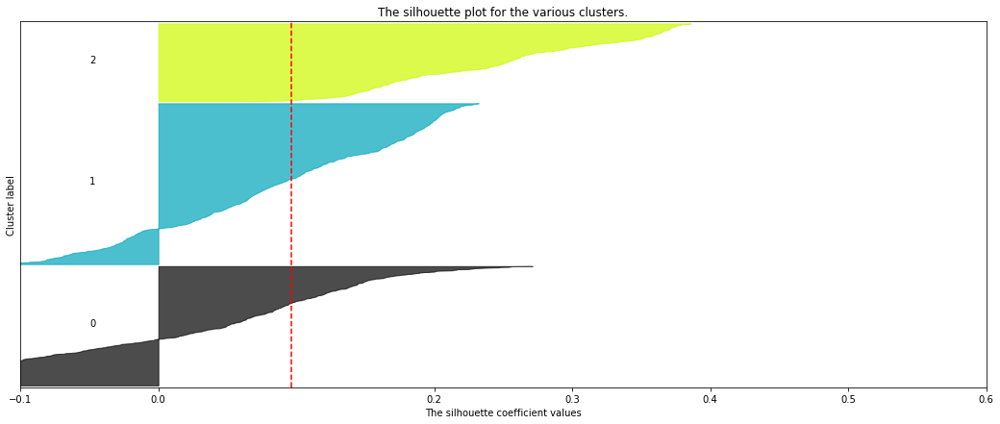

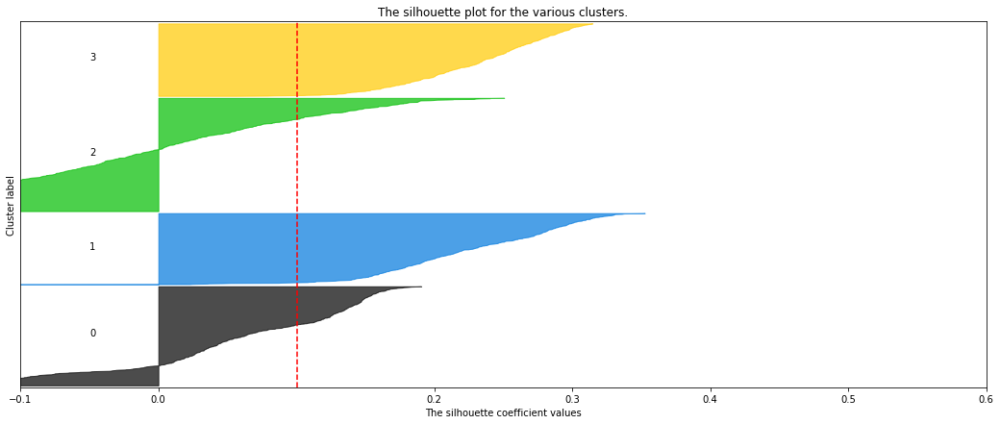

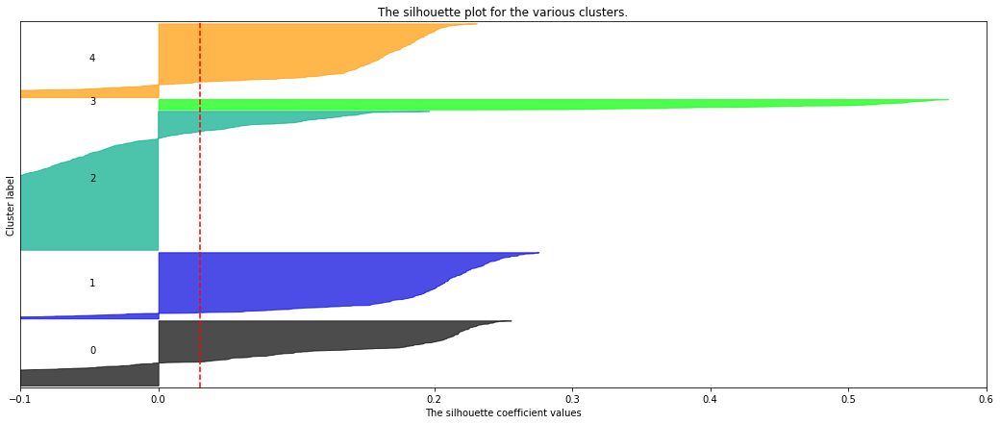

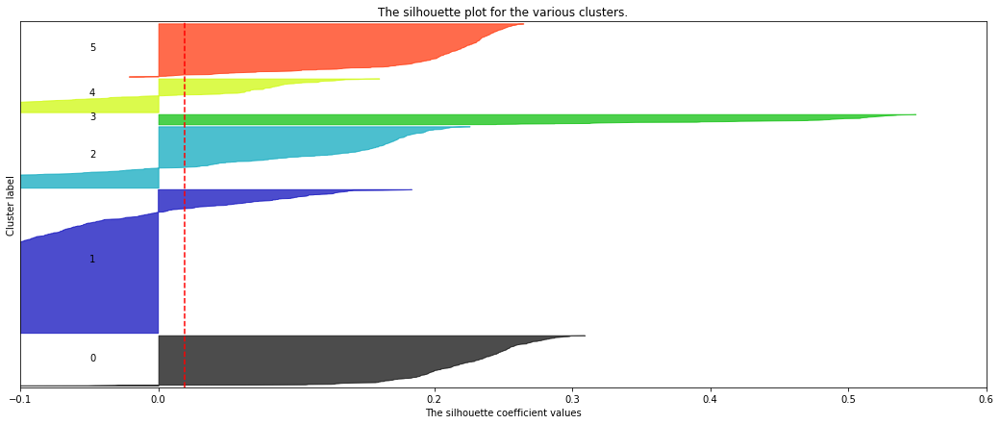

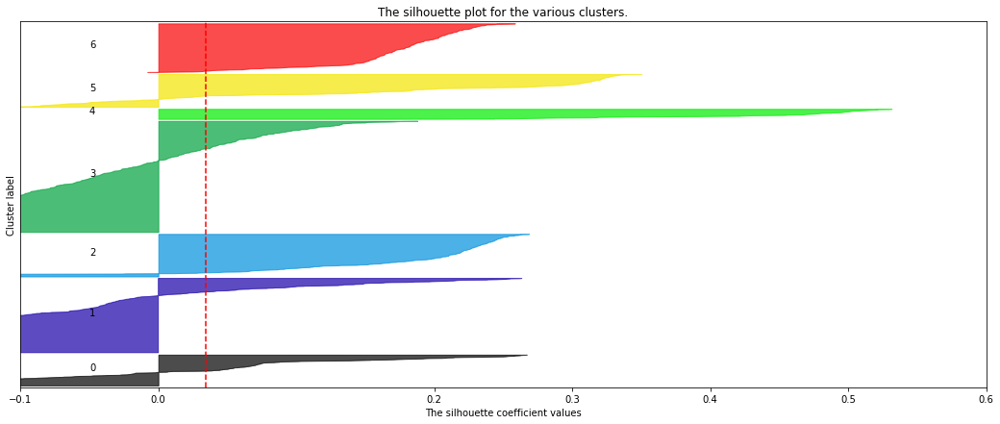

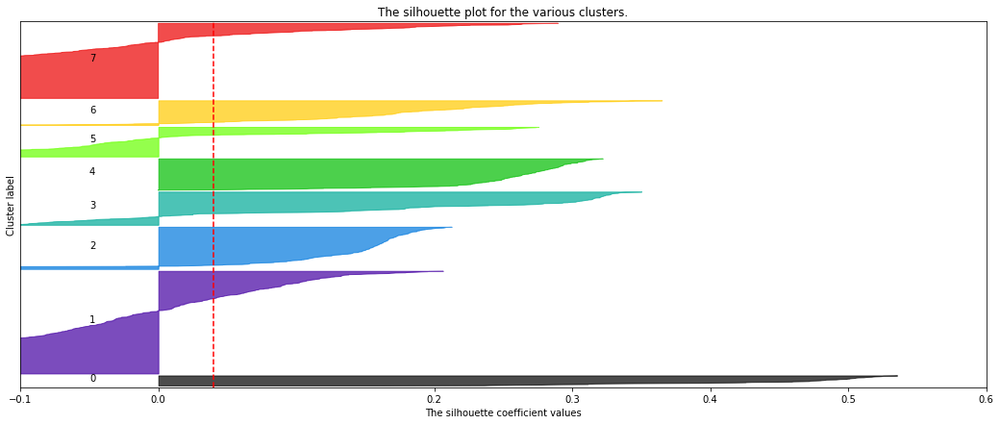

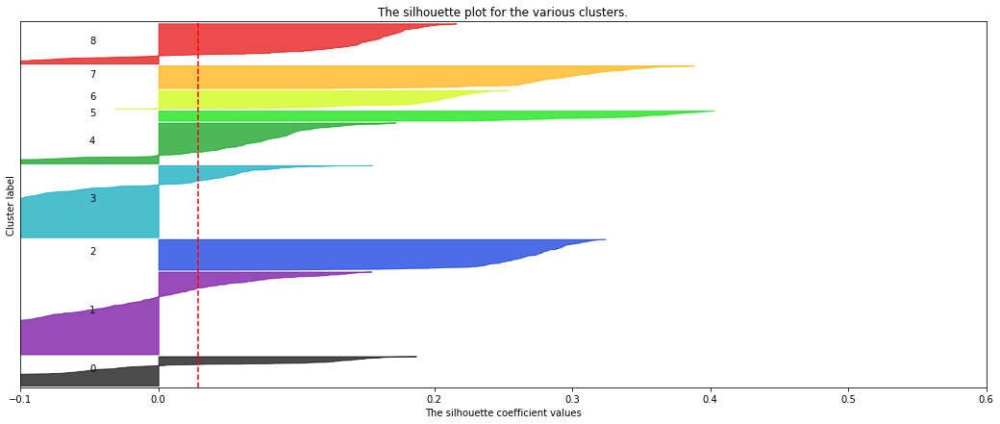

In [ ]:
range_n_clusters = range(2,10)

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1) = plt.subplots(1)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0,1, 0,6]
    _ = ax1.set_xlim([-0.1,0.6])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    _ = ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_scores[n_clusters-2])

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(gower.gower_matrix(X), spectral_results[n_clusters-2],metric='precomputed')

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[spectral_results[n_clusters-2] == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        _ = ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        _ = ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    _ = ax1.set_title("The silhouette plot for the various clusters.")
    _ = ax1.set_xlabel("The silhouette coefficient values")
    _ = ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    _ = ax1.axvline(x=silhouette_scores[n_clusters-2], color="red", linestyle="--")

    _ = ax1.set_yticks([])  # Clear the yaxis labels / ticks
    _ = ax1.set_xticks([-0.1, 0, 0.2, 0.3, 0.4,0.5,0.6])

plt.show()

Exactly as stated by the numerical results, by evaluating the tails of these plots, the configuration with two or 4 clusters are the ones that give the best results.

##### Calinski-Harabasz Index

In [ ]:
calinski_harabasz_scores = []

for i in range(2, 10):
  Calinski_Harabasz_score = calinski_harabasz_score(X, spectral_results[i-2])
  print(str(i) + " clusters: " + str(Calinski_Harabasz_score))
  calinski_harabasz_scores.append(Calinski_Harabasz_score)

2 clusters: 288.99278019292245
3 clusters: 203.50846910778753
4 clusters: 198.9891448367403
5 clusters: 156.54269281730154
6 clusters: 134.01624372759804
7 clusters: 138.51001482338228
8 clusters: 130.85574174319729
9 clusters: 132.48304722253312


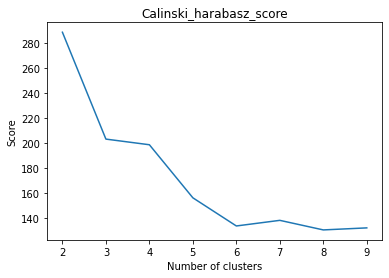

In [ ]:
_ = plt.plot(range(2, 10), calinski_harabasz_scores)
_ = plt.title('Calinski_harabasz_score')
_ = plt.xlabel('Number of clusters')
_ = plt.ylabel('Score')      
plt.show()

Unlike the Mix Distance run, this time the configuration that returns the best score is the one with 2 clusters, followed by 3 clusters and then 4 clusters. Just as before, the values are spread apart.

##### Davies-Bouldin Index

In [ ]:
davies_bouldin_scores = []

for i in range(2, 10):
  Davies_Bouldin_score = davies_bouldin_score(X, spectral_results[i-2])
  print(str(i) + " clusters: " + str(Davies_Bouldin_score))
  davies_bouldin_scores.append(Davies_Bouldin_score)

2 clusters: 2.3845307254421004
3 clusters: 2.5014966288940514
4 clusters: 2.4059111949739855
5 clusters: 2.072863439994367
6 clusters: 2.0760182544498815
7 clusters: 2.0408572504759377
8 clusters: 2.0010882348658727
9 clusters: 1.8949472384964703


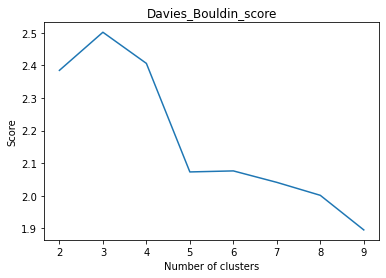

In [ ]:
_ = plt.plot(range(2, 10), davies_bouldin_scores)
_ = plt.title('Davies_Bouldin_score')
_ = plt.xlabel('Number of clusters')
_ = plt.ylabel('Score')      
plt.show()

The results for the Davies-Bouldin metric with the Gower distance are the most different from the others, as the suggested best configuration has 9 clusters, followed by 8 clusters.

The 2/3 clusters configurations that were returned by the other evaluation heuristics here have a relatively high score, being nearly 24% higher in value thant the 9 clusters configuration.

### DBscan

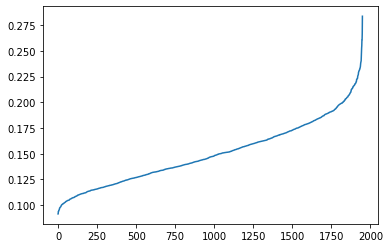

In [ ]:
distances = gower.gower_matrix(X)
sorted_distances = np.sort(distances, axis=0) 
sorted_distances = sorted_distances[60,:]
_ = plt.plot(np.sort(sorted_distances))

The values ​​where the graph shows a knee are in correspondence of 0.11 and 0.20 so these are the best epsilon values.
We discarded the last value because it only had one cluster as output.


In [ ]:
eps = 0.09
dbscan_labels_1 = DBSCAN(eps=eps,min_samples=60,metric='precomputed').fit_predict(distances)

eps = 0.10
dbscan_labels_2 = DBSCAN(eps=eps,min_samples=60,metric='precomputed').fit_predict(distances)

eps = 0.11
dbscan_labels_3 = DBSCAN(eps=eps,min_samples=60,metric='precomputed').fit_predict(distances)

eps = 0.12
dbscan_labels_4 = DBSCAN(eps=eps,min_samples=60,metric='precomputed').fit_predict(distances)

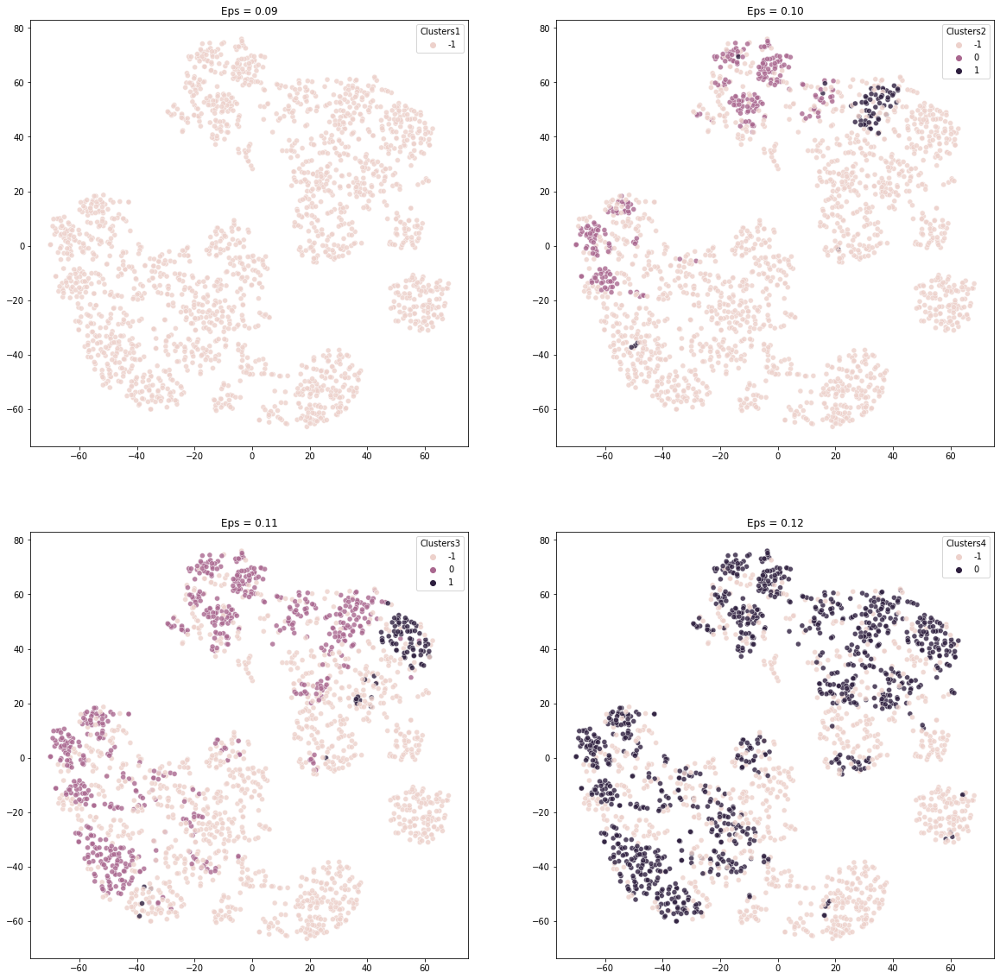

In [ ]:
Y= X_readable.copy()
Y['Clusters1'] = dbscan_labels_1
Y['Clusters2'] = dbscan_labels_2
Y['Clusters3'] = dbscan_labels_3
Y['Clusters4'] = dbscan_labels_4

fig, axs = plt.subplots(2, 2, figsize=(20,20))

_ = axs[0][0].set_title('Eps = 0.09')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0],y=tsne_results_gower[:,1],
    alpha=0.8,
    data=Y,
    hue='Clusters1',
    ax=axs[0][0]
)

_ = axs[0][1].set_title('Eps = 0.10')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0],y=tsne_results_gower[:,1],
    alpha=0.8,
    data=Y,
    hue='Clusters2',
    ax=axs[0][1]
)
_ = axs[1][0].set_title('Eps = 0.11')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0],y=tsne_results_gower[:,1],
    alpha=0.8,
    data=Y,
    hue='Clusters3',
    ax=axs[1][0]
)

_ = axs[1][1].set_title('Eps = 0.12')
_ = sns.scatterplot(
    x=tsne_results_gower[:,0],y=tsne_results_gower[:,1],
    alpha=0.8,
    data=Y,
    hue='Clusters4',
    ax=axs[1][1]
)

In the first graph, we see that the output is represented only by outliers, this means that the epsilon value is too small.
The best result is the one obtained with epsilon at 0.11. The graph shows that two clusters with the presence of outliers certainly fewer than those present in the graph with an epsilon value set at 0.10.
The last graph shows that by increasing a little the epsilon we are losing a cluster.
Given the results, this clustering technique is probably not the best to use in our dataset.

# CONCLUSIONS

As we can see from the code above for clustering we used the same algorithms with two different metrics, the Gower Distance and the Mix Distance (a metric we implemented along the lines of that given in the classroom).
From the results obtained, it can be seen that where we have used the GowerDistance the clusters are not delineated, probably due to the clear division that Gower places between the female gender, which in all the graphs plotted is on the bottom, and the male one, shown on the top.
















##Applied analytical results

**After gathering all of the analytical results that we have derived from the evaluation methods performed for each of the clustering techniques used, the best results seem to be the configurations that group our dataset with two or three clusters.**

**When applying these results to our knownledge of the datasets and comparing them to the groups that we theorized in the beginning, it appears obvious that catagorizing all the population of a bank's clients simply in two or three major groups is unappropriate, as there should be multiple of them. Also, from a bank perspective, these two possible configurations are not usefult, as they would be useless to banks in creating a plan of action for their customers.**

**Hence, instead of simply trusting the results derived from the used heuristics, we surmised it would give a far more significative result to set a higher number of cluster for our conclusions.**

**K-Medoids** : Analytically, the best solution would be the one with the presence of 2 at most 3 clusters. 
For a bank, however, a more subtle division could be useful to define an offer that perfectly fits the needs of customers.
Here same possible explanation about the respectively [2](https://drive.google.com/file/d/1x4us-eIdusm8w1NATICStVV1cpF0YoWC/view?usp=sharing),[3](https://drive.google.com/file/d/1SoPA9I6NlRfW8sQHZwBVlkkkJ3e7FhH2/view?usp=sharing),[5](https://drive.google.com/file/d/1w7aEcNPgsCe_Ybgut4fq9y_cuv3EAx9H/view?usp=sharing) cluster. It is important to note that the latter is probably the one that divides people's datasets best.

**2 CLUSTER**

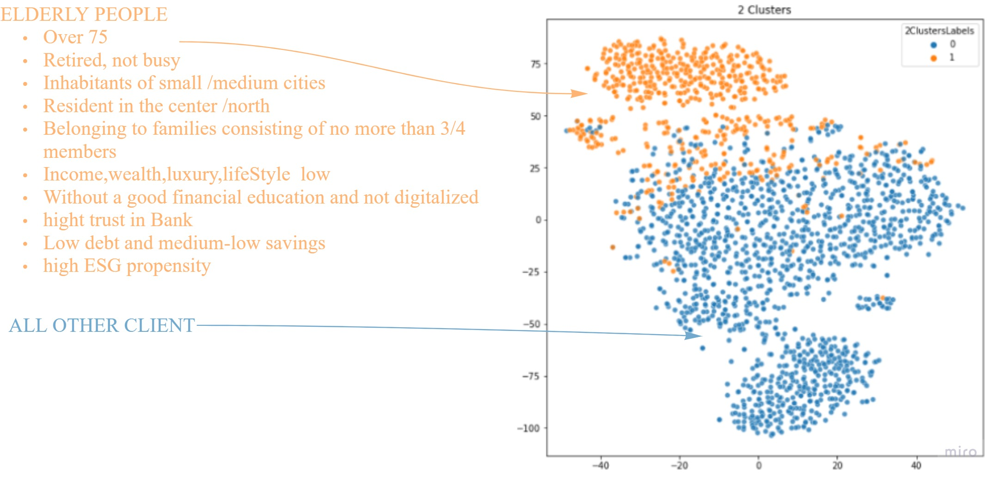

**3 CLUSTER**

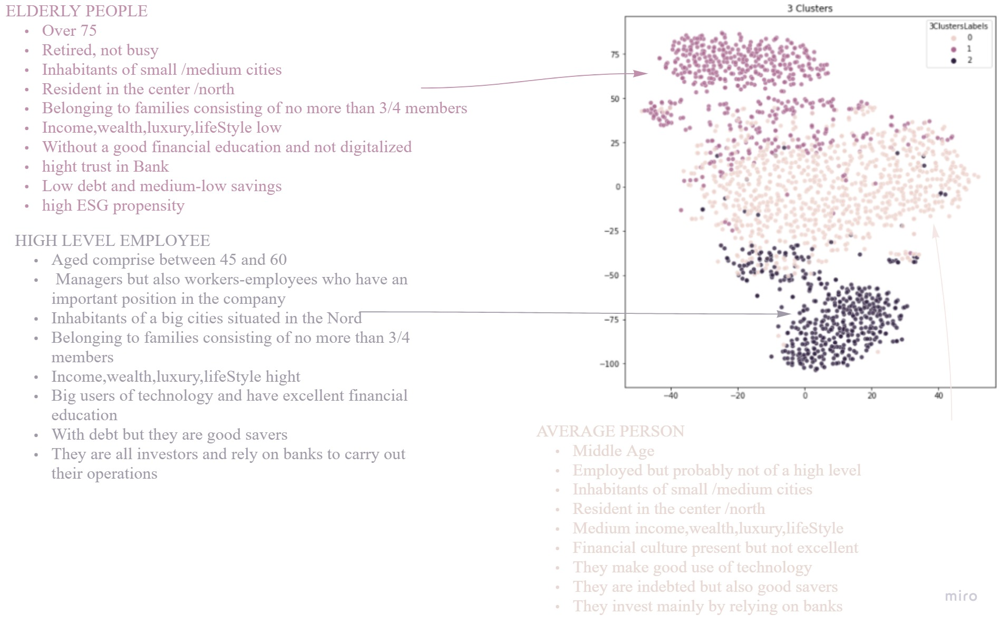

**5 CLUSTER**

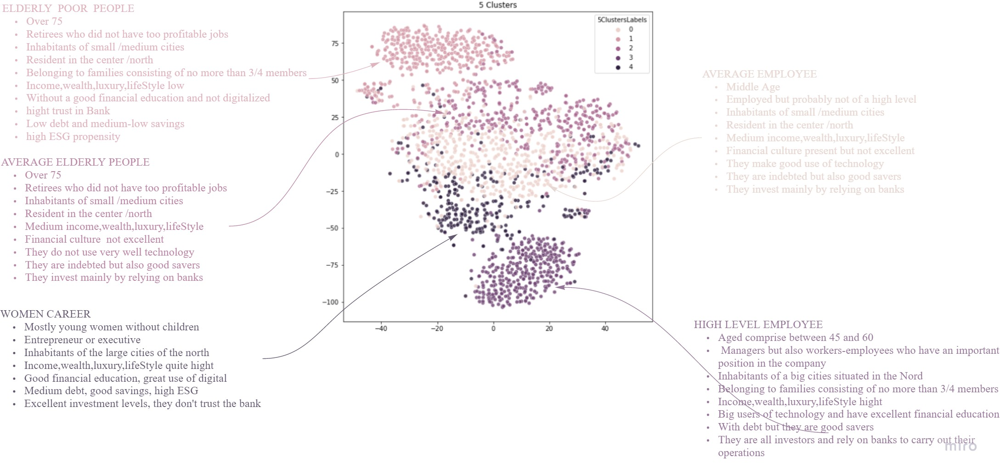

**Spectral Clustering** : Exactly as the KMedoids algorithm, the evaluation heuristics performed on the Spectral Clustering too suggests using 2/3 clusters to group all of our data points. 

When looking the plots with more clusters used, like 4 and 5 clusters, we notice that they are able to better capture some of the characteristics of our data that we highlighted with the Mix Distance and Gower plots, segmentating our population with more precision and providing more useful insight.

**4 CLUSTERS**
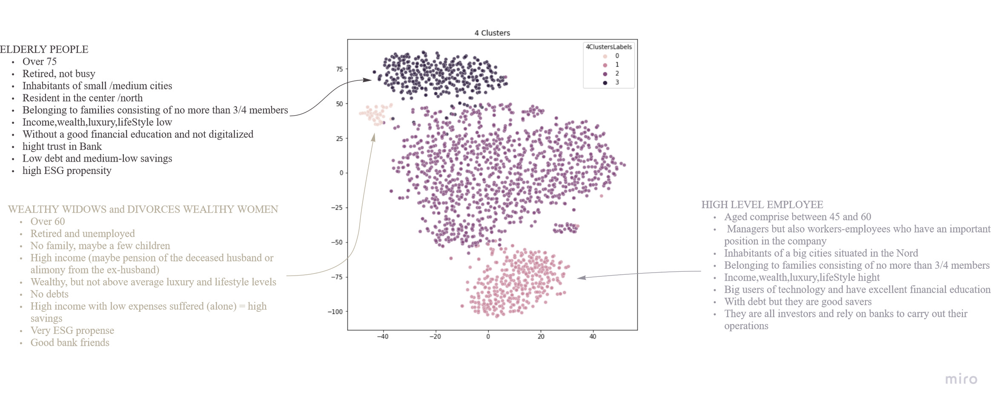

**5 CLUSTERS**
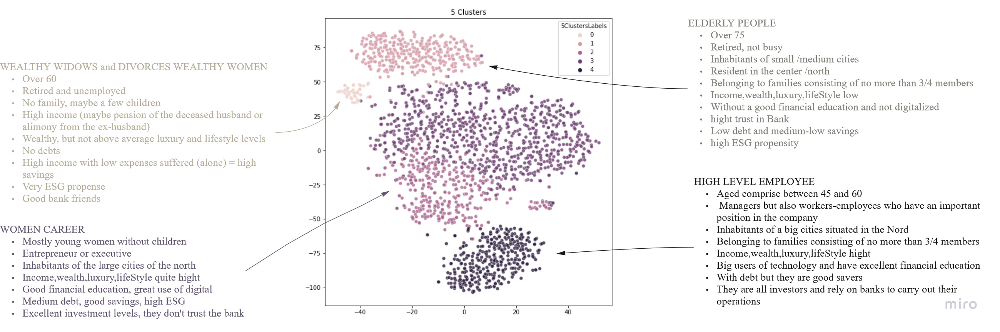